In [1]:
from __future__ import absolute_import, division, print_function
#..
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
#import pyart.graph.cm as pcm
import matplotlib.colors as colors
from matplotlib.colors import LogNorm
from netCDF4 import num2date,date2num,Dataset
import matplotlib._pylab_helpers
#from joblib import Parallel, delayed
import os,subprocess,time,copy
import random
import scipy
import math
import matplotlib.gridspec as gridspec
#import cPickle as pickle
import pickle
import pymc
#import pymc3
#import pyGPs
#..
import pathlib
import pandas as pd
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
print(tf.__version__)
#..
import corner
#..
#import pymc
#import pandas as pd
#print('Running on PyMC3 v{}'.format(pm.__version__))
#import theano
#import theano.tensor as t
%matplotlib inline

1.13.1


## New as of Nov 7 2019
With somewhat rejiggered output values?

## New as of April 22 2020
Using a different definition of bias. Here we do NOT use Greg's methodology for combining multiple sources of observational information. That's in _00, by the way. Here we pretend we only have one obs, which is the mean when we have multiple sources of obs uncertainty. 

### Here we try combining/blending the predictions from multiple NNs (Taking the average of output)

In [3]:
#..Load in the default and training and eval data
#filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3tuningexp.nc'
#filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3tuningexp.v5.nc'
filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3tuningexp.v5.obsbias_notused.nc'
#filenm = filenm+'tparams_gcmglobalaverages.GISS-E3emulatorguided.v5.obsbias_notused.nc'
nc = Dataset(filenm,'r')
params_all = nc.variables['param_vals'][:,:]
obs_all    = nc.variables['model_annout'][:,:]
nc.close()
#..
print(params_all.shape)
print(obs_all.shape)
#..

(45, 551)
(36, 551)


In [4]:
params_default = params_all[:,0]
obs_default    = obs_all[:,0]
#..
params = params_all[:,1:451]
obs    = obs_all[:,1:451]
#..
params_eval = params_all[:,451:]
obs_eval    = obs_all[:,451:]
#..
print(params_default.shape,params.shape,params_eval.shape)
print(obs_default.shape,obs.shape,obs_eval.shape)

(45,) (45, 450) (45, 100)
(36,) (36, 450) (36, 100)


In [6]:
#..Load in the rerun data (these were rerun from the MCMC selections)
#filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3tuningexp.nc'
#filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3emulatorguided.v5.nc'
filenm = '/Users/marcus/Research/Elsaesser_NASA/'
filenm = filenm+'tparams_gcmglobalaverages.GISS-E3emulatorguided.v5.obsbias_notused.nc'
nc = Dataset(filenm,'r')
params_tune = nc.variables['param_vals'][:,:]
obs_tune    = nc.variables['model_annout'][:,:]
nc.close()
#..
print(params_tune.shape)
print(obs_tune.shape)
#..

#..Need to chop 100 samples off end of these
params_tune = params_tune[:,:-100]
obs_tune    = obs_tune[:,:-100]
print(params_tune.shape)
print(obs_tune.shape)

(45, 300)
(36, 300)
(45, 200)
(36, 200)


In [7]:
#..split and append to train/eval
params = np.hstack((params,params_tune[:,:80],params_tune[:,100:180]))
obs    = np.hstack((obs,obs_tune[:,:80],obs_tune[:,100:180]))
#..
params_eval = np.hstack((params_eval,params_tune[:,80:100],params_tune[:,180:]))
obs_eval = np.hstack((obs_eval,obs_tune[:,80:100],obs_tune[:,180:]))
#..
print(params.shape,obs.shape)
print(params_eval.shape,obs_eval.shape)

(45, 610) (36, 610)
(45, 140) (36, 140)


In [68]:
#obs_labs = ['netrad_toa', 'netheat_grnd', 'albedo', 'swabs', 'olr', 'prec', 'tcc', 'pwv', 'Ttropopause']
obs_labs = ['netrad_toa', 'netheat_grnd', 'albedo', 'swabstoa_ave', 'swabstoa', 'swabstoa_soceans', 'sw_cre',
            'olr_ave', 'olr', 'lw_cre', 'pwv', 'qv_100hpa', 'qv_200hpa', 'qv_600hpa', 'qv_925hpa', 'T_trop',
            'T_100hpa', 'T_200hpa', 'T_600hpa', 'T_925hpa', 'TLWP', 'TIWP', 'prec_mc', 'prec', 'prec_amazon',
            'tcc', 'tcc_isccp', 'tcc_shcu', 'tcc_sc', 'cdnc', 'sfcwind', 'T_for_Phase0.90', 'Z_for_Phase0.90',
            'Trop_Cyclone_Count', 'StreamFunction_DJF', 'StreamFunction_JJA']
# par_labs = ['debdecaytime', 'cdnc_ocean_mc', 'cdnc_land_mc_xs', 'dcw_qc', 'qci_detrainment_multiplier', 
#             'cloudrvl_mstcnv','cloudrvi_mstcnv', 'bsort_enteff1', 'bsort_enteff2', 'urelscale', 
#             'cond_repart_dpscale', 'pthresh_closure2', 'tadjmc1', 'tadjmc2', 'dd_evpeff_qp_scale', 
#             'geometric_fevapfac', 'dp_disp_fac', 'dp_disp_max', 'dp_disp2_fac',
#             'dp_disp2_max', 'dd_detbyent', 'entcon_dd', 'max_dt_overshoot', 'terminal_aspcp', 'mc_tqstar_fac',
#             'mc_fddrt', 'tfmc', 't_homf', 'rhcsl', 'rhctl', 'ni_homfree', 'dcs', 'wb99_rh', 'wact_min', 
#             'pf_by_cf', 'invrelvar', 'ac_time', 'scale_cn', 
#             'scale_iifn', 'scale_difn', 'ifluffy','sfluffy', 'vf_multi', 'vf_mults', 'a_sed_entrain']
par_labs = ['debdecaytime', 'cdnc_ocean_mc', 'cdnc_land_mc_xs', 'dcw_qc', 'qci_detrainment_multiplier',
            'cloudrvl_mstcnv', 'cloudrvi_mstcnv', 'bsort_enteff1', 'bsort_enteff2', 'urelscale', 
            'cond_repart_dpscale', 'pthresh_closure2', 'tadjmc1', 'tadjmc2', 'tadjmc3', 'dd_evpeff_qp_scale',
            'geometric_fevapfac', 'dp_disp_fac', 'dp_disp_max', 'dp_disp2_fac', 'dp_disp2_max', 'dd_detbyent',
            'entcon_dd', 'max_dt_overshoot', 'terminal_aspcp', 'mc_tqstar_fac', 'mc_fddrt', 'tfmc', 'vterm_env',
            't_homf', 'rhcsl', 'rhctl', 'ni_homfree', 'dcs', 'wb99_rh', 'invar_pow', 'ac_time', 'scale_cn', 
            'scale_iifn', 'scale_difn', 'ifluffy', 'sfluffy', 'vf_multi', 'vf_mults', 'a_sed_entrain']
            #'scale_ifn', 'sfluffy', 'vf_mults', 'a_evap_entrain', 'a_sed_entrain']
print(len(obs_labs))
print(len(par_labs))
nobs = len(obs_labs)
npar = len(par_labs)

36
45


In [62]:
#fig,axes=corner.corner(params.T)
#fig.savefig('par_lin.png',dpi=100)

In [61]:
#fig,axes=corner.corner(params.T)
#fig.savefig

In [9]:
#..Normalize the inputs (all ranges 0 to 1)
params_norm = copy.deepcopy(params)
for i in range(npar):
    params_norm[i,:] = (params_norm[i,:]-params_norm[i,:].min())/(params_norm[i,:].max()-params_norm[i,:].min())

#..Standardize the outputs (mean=0, variance=1)
obs_stan = copy.deepcopy(obs)
for i in range(nobs):
    obs_stan[i,:] = (obs_stan[i,:]-obs_stan[i,:].mean())/obs_stan[i,:].std()

In [10]:
#..Do the same for the evaluation dataset, but use the ranges/mean/std from the training dataset
params_eval_norm = copy.deepcopy(params_eval)
for i in range(npar):
    params_eval_norm[i,:] = (params_eval_norm[i,:]-params[i,:].min())/(params[i,:].max()-params[i,:].min())

#..Standardize the outputs (mean=0, variance=1)
obs_eval_stan = copy.deepcopy(obs_eval)
for i in range(nobs):
    obs_eval_stan[i,:] = (obs_eval_stan[i,:]-obs[i,:].mean())/obs[i,:].std()

In [11]:
# Display training progress by printing a single dot for each completed epoch
class PrintDot(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        if epoch % 100 == 0: print('')
        print('.', end='')

In [12]:
def plot_history(history):
    hist = pd.DataFrame(history.history)
    hist['epoch'] = history.epoch

    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Abs Error [MPG]')
    plt.plot(hist['epoch'], hist['mean_absolute_error'],
           label='Train Error')
    plt.plot(hist['epoch'], hist['val_mean_absolute_error'],
           label = 'Val Error')
    plt.plot(hist['epoch'],0.1+0.*hist['epoch'],'k:')
    plt.plot(hist['epoch'],0.2+0.*hist['epoch'],'k:')
    plt.plot(hist['epoch'],0.3+0.*hist['epoch'],'k:')
    plt.plot(hist['epoch'],0.4+0.*hist['epoch'],'k:')
    plt.ylim([0,1])
    plt.legend()

    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Square Error [$MPG^2$]')
    plt.plot(hist['epoch'], hist['mean_squared_error'],
           label='Train Error')
    plt.plot(hist['epoch'], hist['val_mean_squared_error'],
           label = 'Val Error')
    plt.plot(hist['epoch'],0.1+0.*hist['epoch'],'k:')
    plt.plot(hist['epoch'],0.2+0.*hist['epoch'],'k:')
    plt.plot(hist['epoch'],0.3+0.*hist['epoch'],'k:')
    plt.plot(hist['epoch'],0.4+0.*hist['epoch'],'k:')
    plt.ylim([0,1])
    plt.legend()
    plt.show()

In [13]:
#..Build da model ... standard setup
def build_model_00():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(64, activation=tf.nn.relu),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    optimizer = tf.keras.optimizers.RMSprop(0.001)

    model.compile(loss='mean_squared_error',
                  optimizer=optimizer,
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [14]:
model_00 = build_model_00()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_00.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Use tf.cast instead.

....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.......................

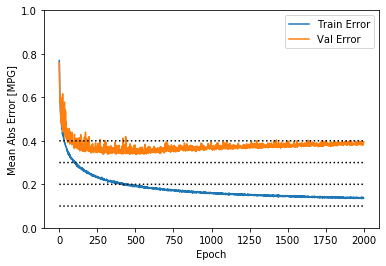

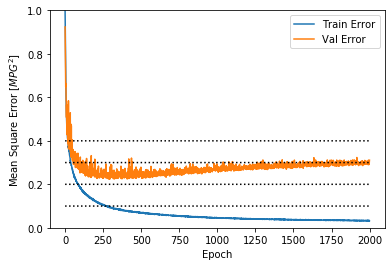

In [15]:
plot_history(history)

In [16]:
#..Build da model ... deep neural network 01  (looks about the same)
def build_model_01():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(256, kernel_initializer='normal',activation='relu'),
                              layers.Dense(256, kernel_initializer='normal',activation='relu'),
                              layers.Dense(256, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [17]:
model_01 = build_model_01()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_01.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

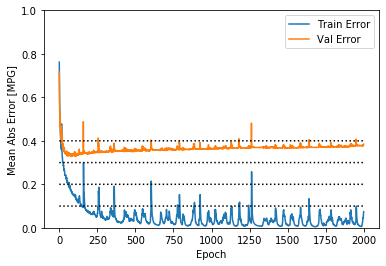

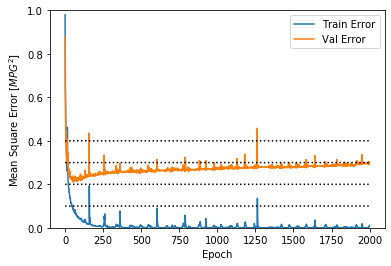

In [18]:
plot_history(history)

In [19]:
#..Build da model ... deep neural network 02  (looks a bit better)
def build_model_02():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(64, kernel_initializer='normal',activation='relu'),
                              layers.Dense(64, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [20]:
model_02 = build_model_02()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_02.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

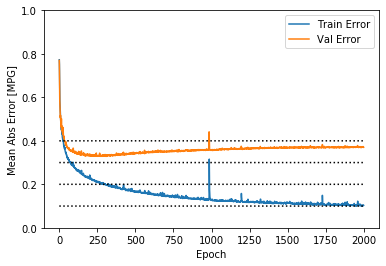

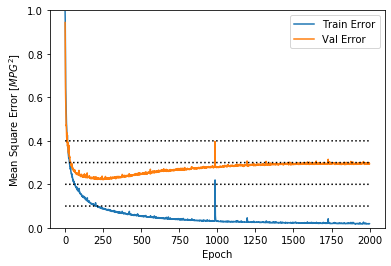

In [21]:
plot_history(history)

In [22]:
#..Build da model ... deep neural network 03 (not any better than 1)
def build_model_03():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(64, kernel_initializer='normal',activation='relu'),
                              layers.Dense(64, kernel_initializer='normal',activation='relu'),
                              layers.Dense(64, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [23]:
model_03 = build_model_03()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_03.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

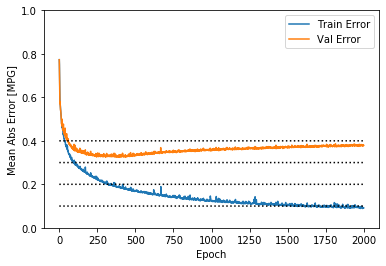

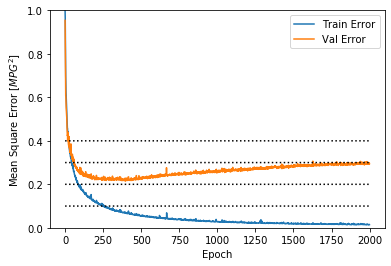

In [24]:
plot_history(history)

In [25]:
#..Build da model ... deep neural network 04  
def build_model_04():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(128, kernel_initializer='normal',activation='relu'),
                              layers.Dense(128, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [26]:
model_04 = build_model_04()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_04.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

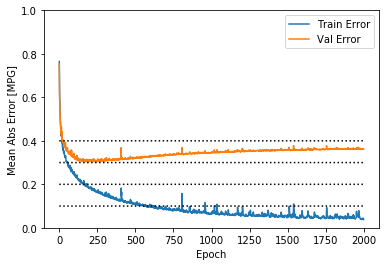

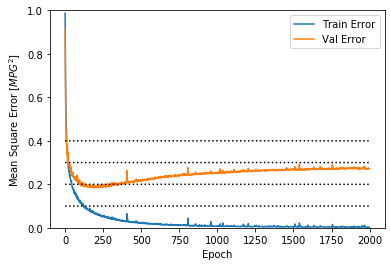

In [27]:
plot_history(history)

In [28]:
#..Build da model ... deep neural network 05  
def build_model_05():
    def lrelu_01(x): return tf.nn.leaky_relu(x, alpha=0.01)
    model = keras.Sequential([layers.Dense(64, activation=lrelu_01, input_shape=[npar]),
                              layers.Dense(64, kernel_initializer='normal',activation=lrelu_01),
                              layers.Dense(64, kernel_initializer='normal',activation=lrelu_01),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [29]:
model_05 = build_model_05()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_05.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

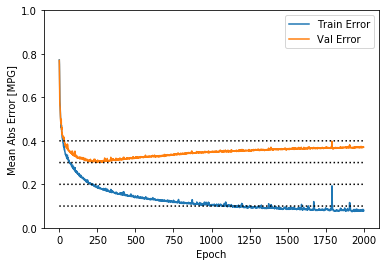

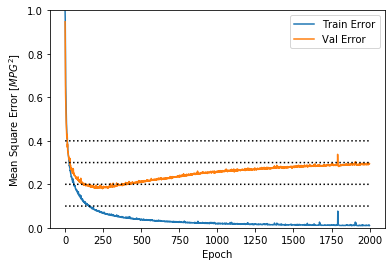

In [30]:
plot_history(history)

In [31]:
#..Build da model ... deep neural network 06 
def build_model_06():
    def lrelu_01(x): return tf.nn.leaky_relu(x, alpha=0.01)
    model = keras.Sequential([layers.Dense(64, activation=lrelu_01, input_shape=[npar]),
                              layers.Dense(64, kernel_initializer='normal',activation=lrelu_01),
                              layers.Dense(64, kernel_initializer='normal',activation=lrelu_01),
                              layers.Dense(64, kernel_initializer='normal',activation=lrelu_01),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [32]:
model_06 = build_model_06()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_06.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

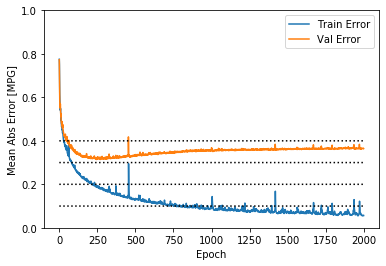

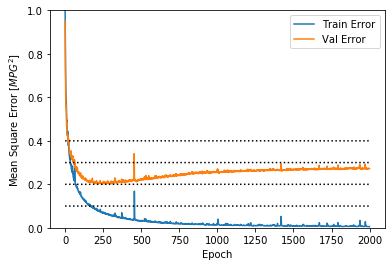

In [33]:
plot_history(history)

In [34]:
#..Build da model ... deep neural network 07
def build_model_07():
    model = keras.Sequential([layers.Dense(40, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [35]:
model_07 = build_model_07()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_07.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

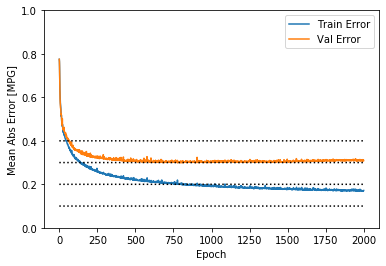

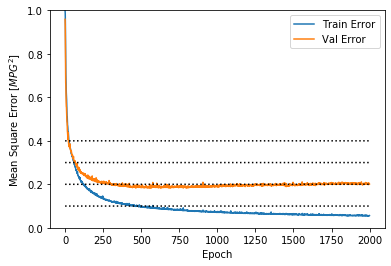

In [36]:
plot_history(history)

In [37]:
#..Build da model ... deep neural network 08
def build_model_08():
    model = keras.Sequential([layers.Dense(40, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [38]:
model_08 = build_model_08()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_08.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

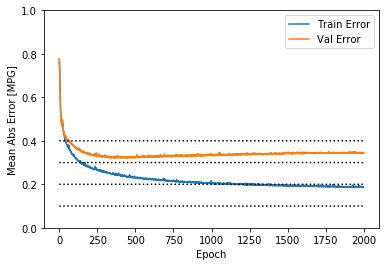

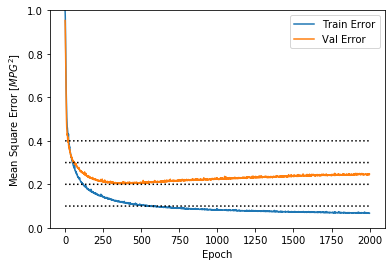

In [39]:
plot_history(history)

In [40]:
#..Build da model ... deep neural network 09
def build_model_09():
    model = keras.Sequential([layers.Dense(40, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              #layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [41]:
model_09 = build_model_09()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_09.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

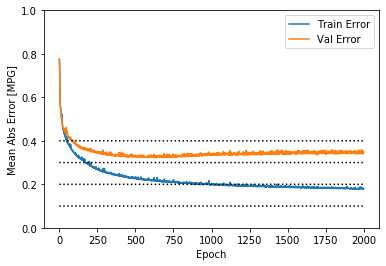

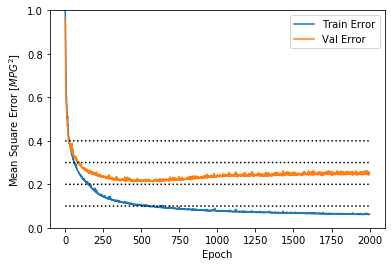

In [42]:
plot_history(history)

In [43]:
#..Build da model ... deep neural network 09
def build_model_10():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(128, kernel_initializer='normal',activation='relu'),
                              #layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(256, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [44]:
model_10 = build_model_10()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_10.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

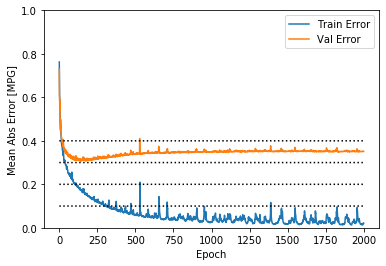

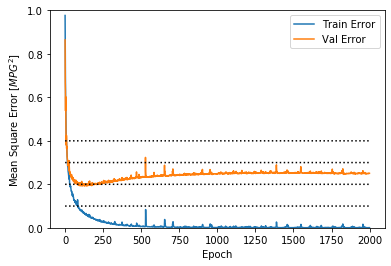

In [45]:
plot_history(history)

In [46]:
#..Build da model ... deep neural network 09
def build_model_11():
    model = keras.Sequential([layers.Dense(64, activation=tf.nn.relu, input_shape=[npar]),
                              layers.Dense(128, kernel_initializer='normal',activation='relu'),
                              #layers.Dense(40, kernel_initializer='normal',activation='relu'),
                              layers.Dense(256, kernel_initializer='normal',activation='relu'),
                              layers.Dense(512, kernel_initializer='normal',activation='relu'),
                              layers.Dense(nobs) ])
#                              layers.Dense(1) ])

    #optimizer = tf.keras.optimizers.RMSprop(0.001)

    #model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    #model.summary()
    
    model.compile(loss='mean_squared_error',
                  #optimizer=optimizer,
                  optimizer='adam',
                  metrics=['mean_absolute_error', 'mean_squared_error'])
    return model

In [47]:
model_11 = build_model_11()
EPOCHS = 2000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model_11.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

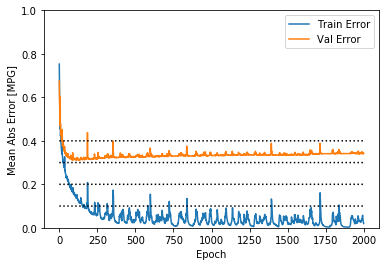

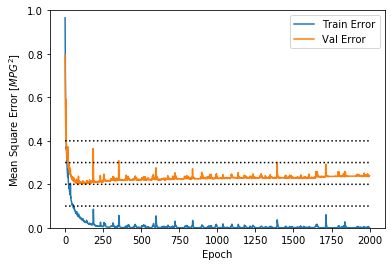

In [48]:
plot_history(history)

In [51]:
#..old
model_02 = build_model_02()
model_03 = build_model_03()
model_05 = build_model_05()
model_07 = build_model_07()
model_08 = build_model_08()
model_09 = build_model_09()

In [41]:
#..newer
model_02 = build_model_02()
model_04 = build_model_03()
model_05 = build_model_05()
model_06 = build_model_07()
model_08 = build_model_08()
model_09 = build_model_09()

In [43]:
#newest
model_01 = build_model_01()
model_02 = build_model_02()
model_03 = build_model_03()
model_04 = build_model_04()
model_05 = build_model_05()
model_08 = build_model_08()
model_09 = build_model_09()

In [49]:
#newester
model_01 = build_model_01()
model_02 = build_model_02()
model_04 = build_model_04()
model_05 = build_model_05()
model_06 = build_model_06()
model_11 = build_model_11()


In [55]:
#new for NNv5_02
model_04 = build_model_04()
model_05 = build_model_05()
model_07 = build_model_07()
model_10 = build_model_10()

In [9]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 40)                1800      
_________________________________________________________________
dense_1 (Dense)              (None, 40)                1640      
_________________________________________________________________
dense_2 (Dense)              (None, 40)                1640      
_________________________________________________________________
dense_3 (Dense)              (None, 40)                1640      
_________________________________________________________________
dense_4 (Dense)              (None, 36)                1476      
Total params: 8,196
Trainable params: 8,196
Non-trainable params: 0
_________________________________________________________________


In [10]:
100/430

0.23255813953488372

In [91]:
print(obs_stan.shape)

(30, 520)


In [15]:
EPOCHS = 3000        
#EPOCHS = 5000

#history = model.fit(params_norm.T, obs_stan[0,:], epochs=EPOCHS, validation_split = 0.232558, verbose=0,
#history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, validation_split = 0.2, verbose=0,
history = model.fit(params_norm.T, obs_stan.T, epochs=EPOCHS, 
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], 
                    verbose=0,
                    callbacks=[PrintDot()])


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........................................................................................

In [16]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,mean_absolute_error,mean_squared_error,val_loss,val_mean_absolute_error,val_mean_squared_error,epoch
2995,0.047744,0.164849,0.047744,0.408847,0.479416,0.408847,2995
2996,0.047578,0.164294,0.047578,0.408729,0.480733,0.408728,2996
2997,0.049019,0.167360,0.049019,0.406939,0.478141,0.406939,2997
2998,0.049644,0.168805,0.049644,0.410962,0.481451,0.410962,2998
2999,0.048067,0.164997,0.048067,0.407763,0.479934,0.407763,2999


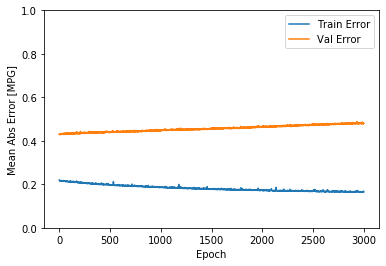

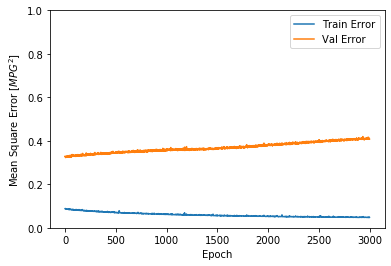

In [17]:
plot_history(history)

In [19]:
loss, mae, mse = model.evaluate(params_eval_norm.T, obs_eval_stan[0,:], verbose=0)

print("Testing set Mean Abs Error: {:5.2f} Things".format(mae))

Testing set Mean Abs Error:  1.13 Things


In [20]:
test_predictions = model.predict(params_eval_norm.T)
print(test_predictions.shape)

(100, 36)


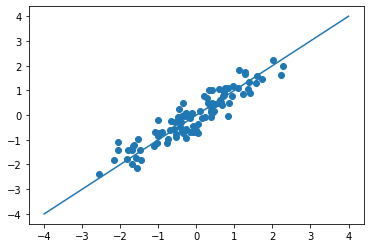

In [21]:
plt.scatter(obs_eval_stan[0,:], test_predictions[:,0])
# plt.xlabel('True Values [MPG]')
# plt.ylabel('Predictions [MPG]')
# plt.axis('equal')
# plt.axis('square')
# plt.xlim([0,plt.xlim()[1]])
# plt.ylim([0,plt.ylim()[1]])
# _ = plt.plot([-100, 100], [-100, 100])
plt.plot([-4,4],[-4,4])


....................................................................................................
....................................................................................................
................................................................

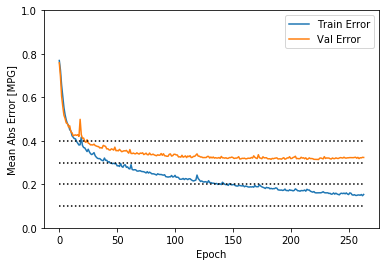

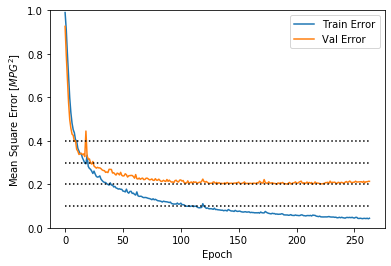


....................................................................................................
....................................................................................................
.............................................................................

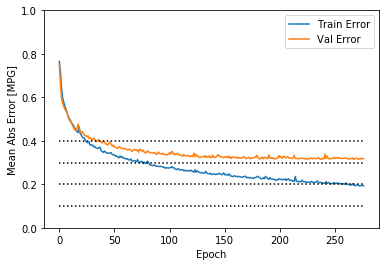

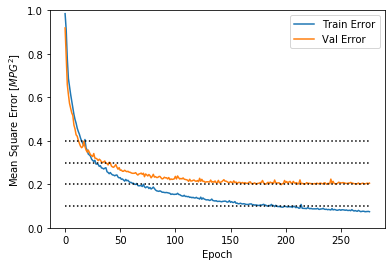


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
................................................................

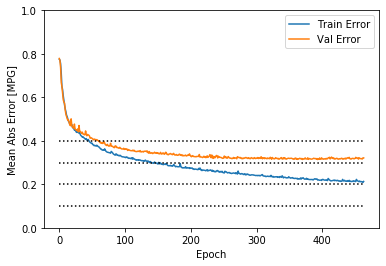

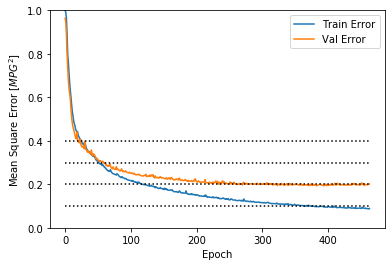


....................................................................................................
....................................................................................................
.......

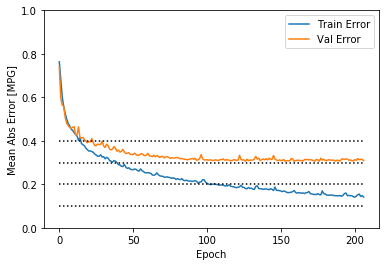

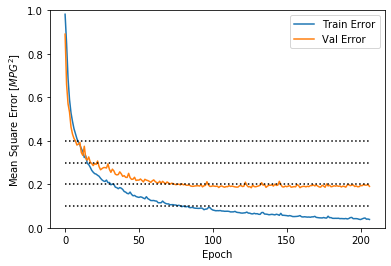

In [56]:
#..This is the old ensemble of NN's (pre-10/27/2019): 02,03,05,07,08,09
#..The new one (post-10/27/2019) is: 02,04,05,06,08,09
#model_02 = build_model()
EPOCHS = 3000
# The patience parameter is the amount of epochs to check for improvement
early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=80)

history = model_04.fit(params_norm.T, obs_stan.T, epochs=EPOCHS,
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], verbose=0, 
                    callbacks=[early_stop, PrintDot()])
plot_history(history)
#..
history = model_05.fit(params_norm.T, obs_stan.T, epochs=EPOCHS,
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], verbose=0, 
                    callbacks=[early_stop, PrintDot()])
plot_history(history)
#..
history = model_07.fit(params_norm.T, obs_stan.T, epochs=EPOCHS,
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], verbose=0, 
                    callbacks=[early_stop, PrintDot()])
plot_history(history)
#..
history = model_10.fit(params_norm.T, obs_stan.T, epochs=EPOCHS,
                    validation_data = [params_eval_norm.T,obs_eval_stan.T], verbose=0, 
                    callbacks=[early_stop, PrintDot()])
plot_history(history)
# #..
# history = model_06.fit(params_norm.T, obs_stan.T, epochs=EPOCHS,
#                     validation_data = [params_eval_norm.T,obs_eval_stan.T], verbose=0, 
#                     callbacks=[early_stop, PrintDot()])
# plot_history(history)
# #..
# history = model_11.fit(params_norm.T, obs_stan.T, epochs=EPOCHS,
#                     validation_data = [params_eval_norm.T,obs_eval_stan.T], verbose=0, 
#                     callbacks=[early_stop, PrintDot()])
# plot_history(history)
# #..

In [53]:
#..OLD
test_predictions = (model_02.predict(params_eval_norm.T) + model_03.predict(params_eval_norm.T) +
                   model_05.predict(params_eval_norm.T) + model_07.predict(params_eval_norm.T) +
                   model_08.predict(params_eval_norm.T) + model_09.predict(params_eval_norm.T))/6.

print(test_predictions.shape)

(100, 36)


In [43]:
#..NEW
test_predictions = (model_02.predict(params_eval_norm.T) + model_04.predict(params_eval_norm.T) +
                   model_05.predict(params_eval_norm.T) + model_06.predict(params_eval_norm.T) +
                   model_08.predict(params_eval_norm.T) + model_09.predict(params_eval_norm.T))/6.

print(test_predictions.shape)

(100, 36)


In [60]:
#..NEWEST
test_predictions = (model_01.predict(params_eval_norm.T) + model_02.predict(params_eval_norm.T) + 
                    model_03.predict(params_eval_norm.T) +
                   model_04.predict(params_eval_norm.T) + model_05.predict(params_eval_norm.T) +
                   model_08.predict(params_eval_norm.T) + model_09.predict(params_eval_norm.T))/7.

print(test_predictions.shape)

(120, 36)


In [91]:
#..NEWESTER
test_predictions = (model_01.predict(params_eval_norm.T) + model_02.predict(params_eval_norm.T) + 
                   model_04.predict(params_eval_norm.T) + model_05.predict(params_eval_norm.T) +
                   model_06.predict(params_eval_norm.T) + model_11.predict(params_eval_norm.T))/6.

print(test_predictions.shape)

(140, 36)


In [57]:
#..New for NNv5_02
test_predictions = (model_04.predict(params_eval_norm.T) + model_05.predict(params_eval_norm.T) +
                   model_07.predict(params_eval_norm.T) + model_10.predict(params_eval_norm.T))/4.

print(test_predictions.shape)

(140, 36)


In [61]:
test_predictions = model_09.predict(params_eval_norm.T)

In [35]:
print(params_eval_norm[:,0].shape)
test_test = model.predict(params_eval_norm[:,i].T)
print(test_test[0,:].shape)

(43,)


ValueError: Error when checking input: expected dense_30_input to have shape (43,) but got array with shape (1,)

(36, 2)


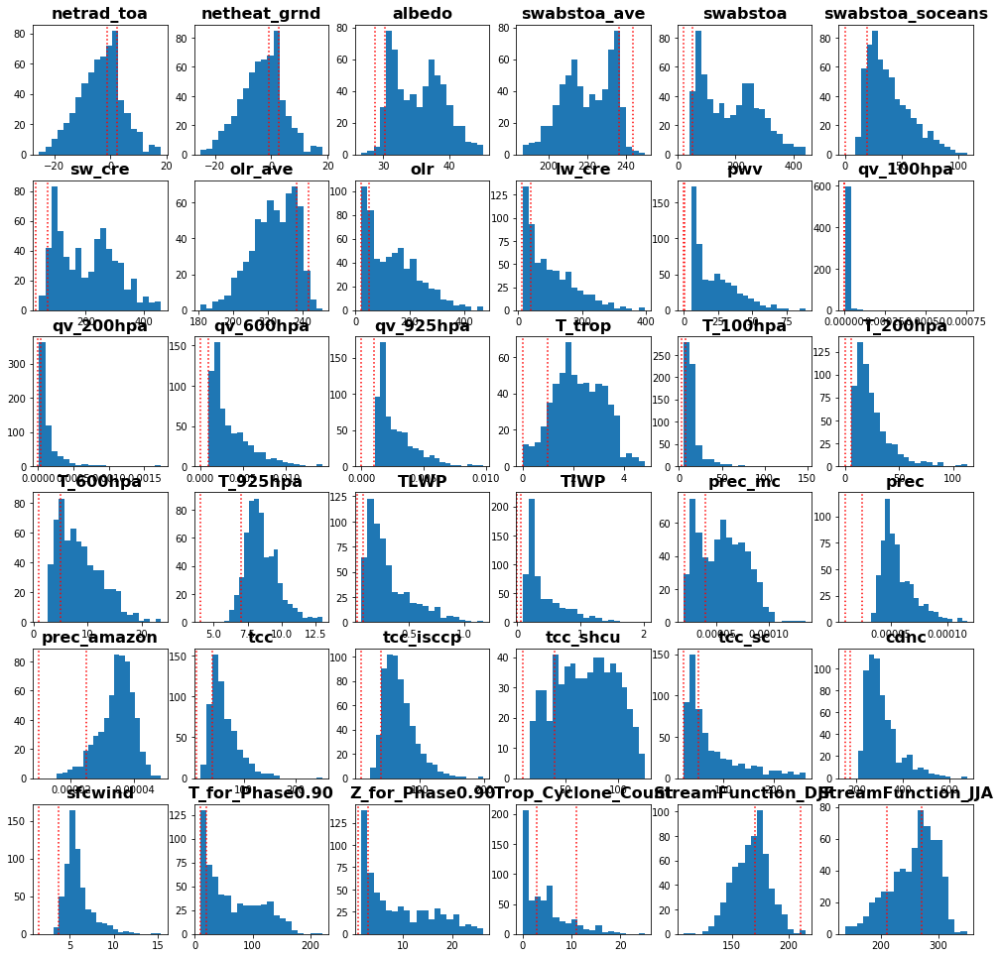

In [58]:
#..Before we move on, let's implement the log likelihood and test the average log-likelihood for all 
#..evaluation points

#..First, let's look at the min/max values of each obs variable for the training data
#for i in range(nobs):
#    print(str(obs[i,:].min()),str(obs[i,:].max()))

#..Greg's suggestions:
gminmax = np.array([[-1.0,   2.5],         #..00
                    [-1.0,    2.5],        #..01 
                    [28.75, 30.25],        #..02
                    [236.5, 243.5],        #..03
                    [20.,     50.],        #..04
                    [ 0.,     20.],        #..05
                    [30.,     70.],        #..06
                    [236.5, 243.5],        #..07
                    [20.,     50.],        #..08
                    [10.,     40.],        #..09
                    [0.,       1.],        #..10
                    [2e-6,   4e-6],        #..11
                    [0.,  0.00003],        #..12
                    [0.,    0.001],        #..13
                    [0.,    0.001],        #..14
                    [0.,       1.],        #..15
                    [3.,       8.],        #..16
                    [0.,       6.],        #..17
                    [1.,       5.],        #..18
                    [4.,       7.],        #..19
                    [0.03,   0.08],        #..20
                    [0.00,   0.05],        #..21
                    [2.e-5, 4.e-5],        #..22
                    [1e-5, 2.5e-5],        #..23
                    [1e-5, 2.5e-5],        #..24
                    [10.,      40],        #..25
                    [10.,      40],        #..26
                    [10.,      40],        #..27
                    [20.,      50],        #..28
                    [150.,   175.],        #..29
                    [1.5,    3.75],        #..30
                    [10.,     20.],        #..31
                    [1.,       3.],        #..32
                    [3.,      11.],        #..33
                    [170.,   210.],        #..34
                    [210.,   270.],  ] )   #..35
print(gminmax.shape)


fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(6,6)
ii=1
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    ak=ax.hist(obs[i,:],bins=20)
    ax.axvline(gminmax[i,0],c='r',ls=':')
    ax.axvline(gminmax[i,1],c='r',ls=':')
    plt.title(obs_labs[i],fontsize=16,fontweight='bold')
gs.update(hspace=.2,top=.96,bottom=0.05,right=0.99,left=0.05)

fig.savefig('summary_of_lhs_v5_02.pdf')       #..00

In [59]:
#..standardize gminmax
gminmax_stan = copy.deepcopy(gminmax)
zero_stan = []
for i in range(nobs):
    gminmax_stan[i,:] = (gminmax_stan[i,:]-obs[i,:].mean())/obs[i,:].std()
    zero_stan = np.r_[zero_stan,(0.-obs[i,:].mean())/obs[i,:].std()]

In [60]:
#..Now define a more "realistic" obs array
#omin = np.array([-0.5,  -0.5,   29.,   238.,    237.,    2.6,   57.,   24.,  -82.])
#omax = np.array([ 1.5,   1.5,   30.,   241.5,   240.5,   3.2,   70.,   26.,  -78.])
omin = gminmax[:,0]
omax = gminmax[:,1]

#..Make some wonky Gaussians for this
omean = 0.5*(omin+omax)
ostd  = 0.25*(omax-omin)

#..If these are RMSE, do something a bit different. Set the mean to 0, set std. dev = 0.5*omax
is_rmse = [False, False, False, False, True,  True,  True,  False, True,  True, 
           True,  True,  True,  True,  True,  False, True,  True,  True,  True,
           True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
           True,  True,  True,  False, False, False]
for i in range(nobs):
    if is_rmse[i]:
        omean[i] = 0.
        ostd[i]  = 0.5*omax[i]
print(omean)
print(ostd)
        
#..Now standardize
omean_stan = copy.deepcopy(omean)
ostd_stan  = copy.deepcopy(ostd)
for i in range(nobs):
    omean_stan[i] = (omean_stan[i]-obs[i,:].mean())/obs[i,:].std()
    ostd_stan[i]  = ostd_stan[i]/obs[i,:].std()
    
print(omean_stan)
print(ostd_stan)


[  0.75   0.75  29.5  240.     0.     0.     0.   240.     0.     0.
   0.     0.     0.     0.     0.     0.5    0.     0.     0.     0.
   0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
   0.     0.     0.     7.   190.   240.  ]
[8.750e-01 8.750e-01 3.750e-01 1.750e+00 2.500e+01 1.000e+01 3.500e+01
 1.750e+00 2.500e+01 2.000e+01 5.000e-01 2.000e-06 1.500e-05 5.000e-04
 5.000e-04 2.500e-01 4.000e+00 3.000e+00 2.500e+00 3.500e+00 4.000e-02
 2.500e-02 2.000e-05 1.250e-05 1.250e-05 2.000e+01 2.000e+01 2.000e+01
 2.500e+01 8.750e+01 1.875e+00 1.000e+01 1.500e+00 2.000e+00 1.000e+01
 1.500e+01]
[ 0.54804784  0.53895574 -1.54431362  1.54186882 -1.87681115 -2.07877647
 -2.07979246  1.295391   -1.49517213 -1.30864442 -1.41553744 -0.37649382
 -0.7373717  -1.51095013 -1.83626125 -1.76508235 -1.28443632 -1.55447171
 -2.14728741 -7.05298443 -1.55038676 -1.33046183 -2.55356138 -3.87594913
 -6.25262812 -2.27432356 -2.82559087 -2.50878414 -1.37341925 -4.40377246
 -3.72352991 -1.3

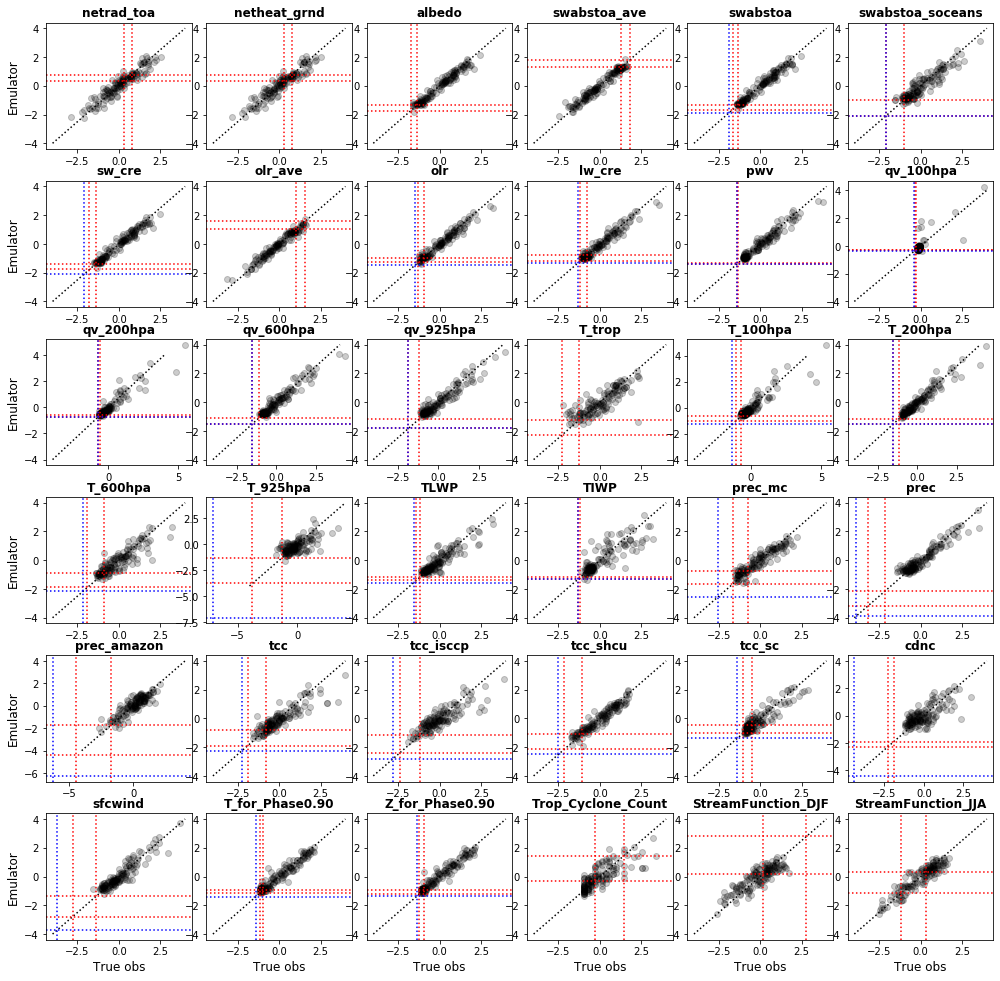

In [61]:
fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(6,6)
ii=1
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    plt.scatter(obs_eval_stan[i,:], test_predictions[:,i],alpha=0.2,c='k')
    plt.plot([-4,4],[-4,4],'k:')
    if True:
        ax.axvline(gminmax_stan[i,0],c='r',ls=':')
        ax.axvline(gminmax_stan[i,1],c='r',ls=':')
        ax.axhline(gminmax_stan[i,0],c='r',ls=':')
        ax.axhline(gminmax_stan[i,1],c='r',ls=':')
        if is_rmse[i]:
            ax.axhline(zero_stan[i],c='b',ls=':')
            ax.axvline(zero_stan[i],c='b',ls=':')
    plt.title(obs_labs[i],fontsize=12,fontweight='bold')
    if (i>29):
        ax.set_xlabel('True obs',fontsize=12)
    if (i % 6 == 0):
        ax.set_ylabel('Emulator',fontsize=12)
    ii +=1
gs.update(hspace=.25,top=.96,bottom=0.05,wspace=0.1,right=0.99,left=0.05)
#fig.savefig('nnv4_linear_dnnMEAN01_traineval_2.png')
fig.savefig('nnv5_linear_dnnMEAN_traineval_02.png')


In [45]:
print( obs[i,:].std())

8.5228815


In [62]:
#..Set up a simple PyMC parameter estimation experiment
def run_emulator(p00,p01,p02,p03,p04,p05,p06,p07,p08,p09,
                  p10,p11,p12,p13,p14,p15,p16,p17,p18,p19,
                  p20,p21,p22,p23,p24,p25,p26,p27,p28,p29,
                  p30,p31,p32,p33,p34,p35,p36,p37,p38,p39,p40,p41,p42,p43,p44):
    #...
    pars = np.array([[p00,p01,p02,p03,p04,p05,p06,p07,p08,p09,
                                 p10,p11,p12,p13,p14,p15,p16,p17,p18,p19,
                                 p20,p21,p22,p23,p24,p25,p26,p27,p28,p29,
                                 p30,p31,p32,p33,p34,p35,p36,p37,p38,p39,p40,p41,p42,p43,p44]])
    #fwd_obs = model.predict(pars)
    fwd_obs = (model_04.predict(pars) + model_05.predict(pars) +
               model_07.predict(pars) + model_10.predict(pars))/4.
    #print(fwd_obs.ravel().shape)
    return fwd_obs.ravel()

In [63]:
#model_01.save('NASA_Elsaesser_NNv5_00_model01_NEW.h5') 
#model_02.save('NASA_Elsaesser_NNv5_00_model02_NEW.h5') 
model_04.save('NASA_Elsaesser_NNv5_02_model04.h5') 
model_05.save('NASA_Elsaesser_NNv5_02_model05.h5') 
model_07.save('NASA_Elsaesser_NNv5_02_model07.h5') 
model_10.save('NASA_Elsaesser_NNv5_02_model10.h5') 


In [102]:
# #..Now define a more "realistic" obs array
# omin = np.array([-0.5,  -0.5,   29.,   238.,    237.,    2.6,   57.,   24.,  -82.])
# omax = np.array([ 1.5,   1.5,   30.,   241.5,   240.5,   3.2,   70.,   26.,  -78.])

# #..Make some wonky Gaussians for this
# omean = 0.5*(omin+omax)
# ostd  = 0.25*(omax-omin)
# print(omean)
# print(ostd)

# #..Now standardize
# omean_stan = copy.deepcopy(omean)
# ostd_stan  = copy.deepcopy(ostd)
# for i in range(nobs):
#     omean_stan[i] = (omean_stan[i]-obs[i,:].mean())/obs[i,:].std()
#     ostd_stan[i]  = ostd_stan[i]/obs[i,:].std()
    
# print(omean_stan)
# print(ostd_stan)

In [64]:


#..Define variables and priors (bounded uniform, you can try Gaussian too)
#..Define prior
p00 = pymc.Uniform('p00',0.,1.)
p01 = pymc.Uniform('p01',0.,1.)
p02 = pymc.Uniform('p02',0.,1.)
p03 = pymc.Uniform('p03',0.,1.)
p04 = pymc.Uniform('p04',0.,1.)
p05 = pymc.Uniform('p05',0.,1.)
p06 = pymc.Uniform('p06',0.,1.)
p07 = pymc.Uniform('p07',0.,1.)
p08 = pymc.Uniform('p08',0.,1.)
p09 = pymc.Uniform('p09',0.,1.)
p10 = pymc.Uniform('p10',0.,1.)
p11 = pymc.Uniform('p11',0.,1.)
p12 = pymc.Uniform('p12',0.,1.)
p13 = pymc.Uniform('p13',0.,1.)
p14 = pymc.Uniform('p14',0.,1.)
p15 = pymc.Uniform('p15',0.,1.)
p16 = pymc.Uniform('p16',0.,1.)
p17 = pymc.Uniform('p17',0.,1.)
p18 = pymc.Uniform('p18',0.,1.)
p19 = pymc.Uniform('p19',0.,1.)
p20 = pymc.Uniform('p20',0.,1.)
p21 = pymc.Uniform('p21',0.,1.)
p22 = pymc.Uniform('p22',0.,1.)
p23 = pymc.Uniform('p23',0.,1.)
p24 = pymc.Uniform('p24',0.,1.)
p25 = pymc.Uniform('p25',0.,1.)
p26 = pymc.Uniform('p26',0.,1.)
p27 = pymc.Uniform('p27',0.,1.)
p28 = pymc.Uniform('p28',0.,1.)
p29 = pymc.Uniform('p29',0.,1.)
p30 = pymc.Uniform('p30',0.,1.)
p31 = pymc.Uniform('p31',0.,1.)
p32 = pymc.Uniform('p32',0.,1.)
p33 = pymc.Uniform('p33',0.,1.)
p34 = pymc.Uniform('p34',0.,1.)
p35 = pymc.Uniform('p35',0.,1.)
p36 = pymc.Uniform('p36',0.,1.)
p37 = pymc.Uniform('p37',0.,1.)
p38 = pymc.Uniform('p38',0.,1.)
p39 = pymc.Uniform('p39',0.,1.)
p40 = pymc.Uniform('p40',0.,1.)
p41 = pymc.Uniform('p41',0.,1.)
p42 = pymc.Uniform('p42',0.,1.)
p43 = pymc.Uniform('p43',0.,1.)
p44 = pymc.Uniform('p44',0.,1.)



#..Define the observation points and the "true" observation
#sigma = 0.1
#Y = np.array([0.,0.,0.,0.,0.,0.,0.,0.,0.])
Rcov = np.eye(nobs)
for i in range(nobs):
     Rcov[i,i] = ostd_stan[i]**2
Y = omean_stan

#..Define the model
@pymc.deterministic
def y_model(p00=p00,p01=p01,p02=p02,p03=p03,p04=p04,p05=p05,p06=p06,p07=p07,p08=p08,p09=p09,
            p10=p10,p11=p11,p12=p12,p13=p13,p14=p14,p15=p15,p16=p16,p17=p17,p18=p18,p19=p19,
            p20=p20,p21=p21,p22=p22,p23=p23,p24=p24,p25=p25,p26=p26,p27=p27,p28=p28,p29=p29,
            p30=p30,p31=p31,p32=p32,p33=p33,p34=p34,p35=p35,p36=p36,p37=p37,p38=p38,p39=p39,
            p40=p40,p41=p41,p42=p42,p43=p43,p44=p44):
    pvec = run_emulator(p00,p01,p02,p03,p04,p05,p06,p07,p08,p09,
                        p10,p11,p12,p13,p14,p15,p16,p17,p18,p19,
                        p20,p21,p22,p23,p24,p25,p26,p27,p28,p29,
                        p30,p31,p32,p33,p34,p35,p36,p37,p38,p39,p40,p41,p42,p43,p44)
    return pvec


#..Define the likelihood (multivariate Gaussian w/ diagnonal error variance)
#y = pymc.MvNormalCov('y',mu=y_model, C=sigma**2*np.eye(9), observed=True, value=Y)
y = pymc.MvNormalCov('y',mu=y_model, C=Rcov, observed=True, value=Y)

#..Bundle everything into a dict
mod = dict(p00=p00,p01=p01,p02=p02,p03=p03,p04=p04,p05=p05,p06=p06,p07=p07,p08=p08,p09=p09,
            p10=p10,p11=p11,p12=p12,p13=p13,p14=p14,p15=p15,p16=p16,p17=p17,p18=p18,p19=p19,
            p20=p20,p21=p21,p22=p22,p23=p23,p24=p24,p25=p25,p26=p26,p27=p27,p28=p28,p29=p29,
            p30=p30,p31=p31,p32=p32,p33=p33,p34=p34,p35=p35,p36=p36,p37=p37,p38=p38,p39=p39,
            p40=p40,p41=p41,p42=p42,p43=p43,p44=p44,y_model=y_model,y=Y)

In [ ]:
#..Run using the standard sampler (metropolis sampler with burn-in) w/independent proposal
S = pymc.MCMC(mod)
S.sample(iter=100000, burn=10000)

 [-----------------96%----------------  ] 96487 of 100000 complete in 72378.5 sec

In [66]:
print(S.summary)

<bound method Sampler.summary of <pymc.MCMC.MCMC object at 0x7f9440fd1f28>>


In [53]:
print(samples.shape)

NameError: name 'samples' is not defined

(array([ 8.,  5., 20., 12., 24., 18.,  8.,  4.,  0.,  1.]),
 array([1039.12981498, 1618.44495591, 2197.76009685, 2777.07523778,
        3356.39037871, 3935.70551964, 4515.02066057, 5094.33580151,
        5673.65094244, 6252.96608337, 6832.2812243 ]),
 <a list of 10 Patch objects>)

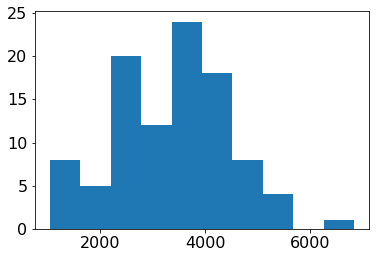

In [77]:
plt.hist(subsamp[0,:])

In [83]:
print(params.shape)
print(samples_unnorm.shape)

(44, 440)
(44, 9000)


In [52]:
print(samples.shape)

NameError: name 'samples' is not defined

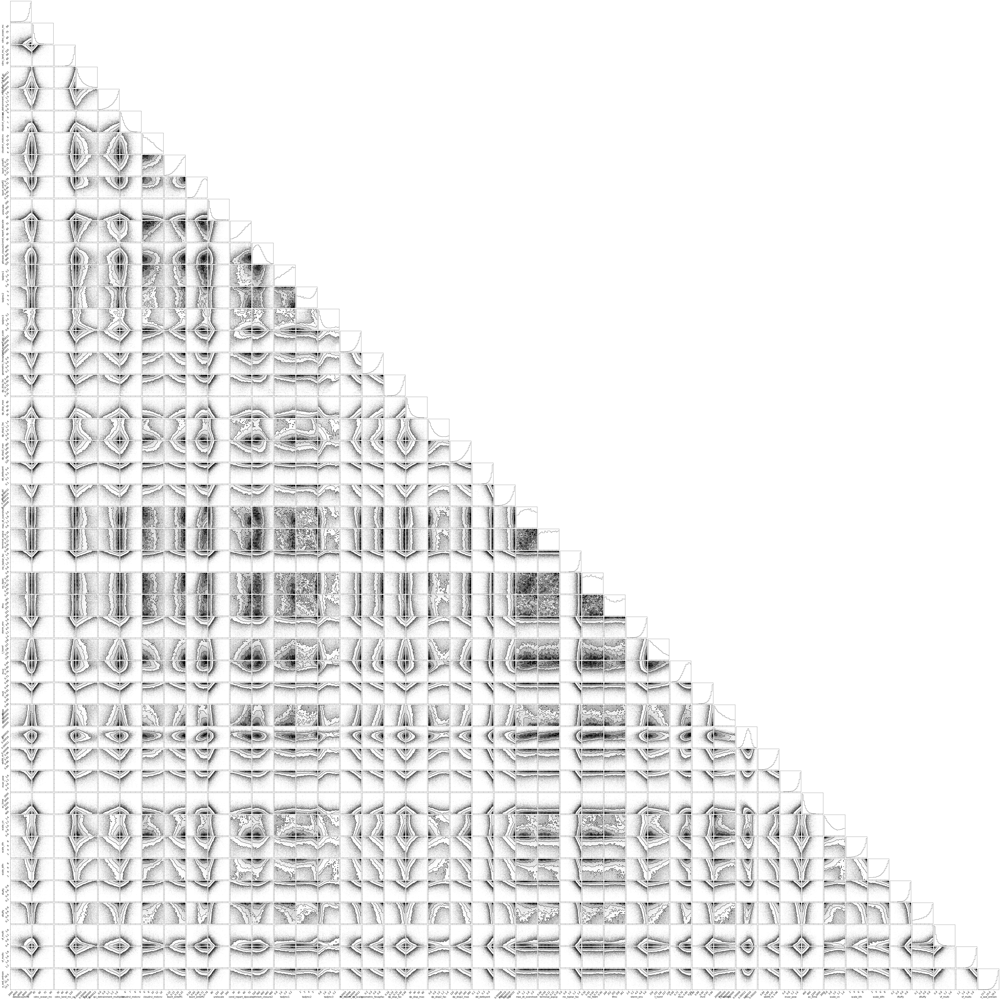

In [69]:
samples = np.vstack((S.trace('p00')[:],S.trace('p01')[:],S.trace('p02')[:],S.trace('p03')[:],S.trace('p04')[:],
                     S.trace('p05')[:],S.trace('p06')[:],S.trace('p07')[:],S.trace('p08')[:],S.trace('p09')[:],
                     S.trace('p10')[:],S.trace('p11')[:],S.trace('p12')[:],S.trace('p13')[:],S.trace('p14')[:],
                     S.trace('p15')[:],S.trace('p16')[:],S.trace('p17')[:],S.trace('p18')[:],S.trace('p19')[:],
                     S.trace('p20')[:],S.trace('p21')[:],S.trace('p22')[:],S.trace('p23')[:],S.trace('p24')[:],
                     S.trace('p25')[:],S.trace('p26')[:],S.trace('p27')[:],S.trace('p28')[:],S.trace('p29')[:],
                     S.trace('p30')[:],S.trace('p31')[:],S.trace('p32')[:],S.trace('p33')[:],S.trace('p34')[:],
                     S.trace('p35')[:],S.trace('p36')[:],S.trace('p37')[:],S.trace('p38')[:],S.trace('p39')[:],
                     S.trace('p40')[:],S.trace('p41')[:],S.trace('p42')[:],S.trace('p43')[:],S.trace('p44')[:]))

samples_unnorm = copy.deepcopy(samples[:,::2])
for i in range(npar):
    samples_unnorm[i,:] = samples_unnorm[i,:]*(params[i,:].max()-params[i,:].min()) + params[i,:].min()

plt.rcParams['font.size'] = 16
#fig,axes = corner.corner(samples.T,labels=par_labs)
 

if False:
    #..Do scatter plot with selected points and *actual* log-likelihood values
    for i in range(npar-1):
        for j in range(npar-1):
            if j>=i:
                #axes[j+1,i].scatter(subsamp[i,:],subsamp[j+1,:],c=like_out_nnMEAN_E3[:,:].sum(axis=1),cmap=cm.jet)
                axes[j+1,i].scatter(subsamp[i,:],subsamp[j+1,:],c=like_out_nnMEAN_nn[:,:].sum(axis=1),cmap=cm.jet)

#plt.colorbar()

#fig.savefig('gissE2_parpost_nnv4_linear_dnnMEAN00_traineval_unnorm_nn.png')
fig.savefig('gissE2_parpost_nnv5_linear_dnnMEAN00_nobias_02.png')


In [ ]:
fig,axes = corner.corner(S.y_model.trace())
fig.savefig('gissE2_outputpost_nnv3_linear_dnn09_traineval.png')

In [141]:
fig.clf()
plt.close(fig)

In [326]:
#..Load in the outputs from ModelE for the samples drawn from the posterior PDF generated using the NN emulator(s)
#filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3tuningexp.nc'
#filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3emulatorguided.v3.nc'
filenm = '/Users/marcus/Research/Elsaesser_NASA/tparams_gcmglobalaverages.GISS-E3emulatorguided.v5.nc'
nc = Dataset(filenm,'r')
params_post_all = nc.variables['param_vals'][:,:]
obs_post_all    = nc.variables['model_annout'][:,:]
nc.close()
#..
print(params_post_all.shape)
print(obs_post_all.shape)
#..
params_post_nn5 = params_post_all[:,0:200]
obs_post_nn5    = obs_post_all[:,0:200]
#..
params_post_nnMEAN5 = params_post_all[:,200:]
obs_post_nnMEAN5    = obs_post_all[:,200:]
#..
print(params_post_nn5.shape)
print(params_post_nnMEAN5.shape)



(45, 300)
(36, 300)
(45, 200)
(45, 100)


In [327]:
#..Run the emulator for the new eval points and check against the actual output
#..first standardize and normalize
#..Do the same for the evaluation dataset, but use the ranges/mean/std from the training dataset
#params_post_nn3_norm = copy.deepcopy(params_post_nn3)        #..these might still be "live"
#params_post_nnMEAN_norm = copy.deepcopy(params_post_nnMEAN)
params_post_nn5_norm = copy.deepcopy(params_post_nn5)
params_post_nnMEAN5_norm = copy.deepcopy(params_post_nnMEAN5)
for i in range(npar):
    params_post_nn5_norm[i,:] = (params_post_nn5_norm[i,:]-params[i,:].min())/(params[i,:].max()-params[i,:].min())
    params_post_nnMEAN5_norm[i,:] = (params_post_nnMEAN5_norm[i,:]- 
                                    params[i,:].min())/(params[i,:].max()-params[i,:].min())

#..Standardize the outputs (mean=0, variance=1)
obs_post_nn5_stan = copy.deepcopy(obs_post_nn5)
obs_post_nnMEAN5_stan = copy.deepcopy(obs_post_nnMEAN5)
for i in range(nobs):
    obs_post_nn5_stan[i,:] = (obs_post_nn5_stan[i,:]-obs[i,:].mean())/obs[i,:].std()
    obs_post_nnMEAN5_stan[i,:] = (obs_post_nnMEAN5_stan[i,:]-obs[i,:].mean())/obs[i,:].std()

In [26]:
# #..Now run the emulator on these datas
# obs_post_nn3_emulator = (model_02.predict(params_post_nn3_norm.T) + model_03.predict(params_post_nn3_norm.T) +
#                    model_05.predict(params_post_nn3_norm.T) + model_07.predict(params_post_nn3_norm.T) +
#                    model_08.predict(params_post_nn3_norm.T) + model_09.predict(params_post_nn3_norm.T))/6.

# print(obs_post_nn3_emulator.shape)

# obs_post_nnMEAN_emulator = (model_02.predict(params_post_nnMEAN_norm.T)+model_03.predict(params_post_nnMEAN_norm.T) +
#                    model_05.predict(params_post_nnMEAN_norm.T) + model_07.predict(params_post_nnMEAN_norm.T) +
#                    model_08.predict(params_post_nnMEAN_norm.T) + model_09.predict(params_post_nnMEAN_norm.T))/6.

# print(obs_post_nn3_emulator.shape)
# print(obs_post_nnMEAN_emulator.shape)
#obs_tune_emulator = model.predict(params_tune_norm.T)
#print(obs_tune_emulator.shape)

(100, 36)
(100, 36)
(100, 36)


In [ ]:
#..Now run the emulator on these datas
obs_post_nn5_emulator = (model_01.predict(params_post_nn5_norm.T) + model_02.predict(params_post_nn5_norm.T) +
                   model_04.predict(params_post_nn5_norm.T) + model_05.predict(params_post_nn5_norm.T) +
                   model_06.predict(params_post_nn5_norm.T) + model_11.predict(params_post_nn5_norm.T))/6.

print(obs_post_nn5_emulator.shape)

obs_post_nnMEAN5_emulator = (model_01.predict(params_post_nnMEAN5_norm.T) +
                             model_02.predict(params_post_nnMEAN5_norm.T) +
                             model_04.predict(params_post_nnMEAN5_norm.T) + 
                             model_05.predict(params_post_nnMEAN5_norm.T) +
                             model_06.predict(params_post_nnMEAN5_norm.T) + 
                             model_11.predict(params_post_nnMEAN5_norm.T))/6.

print(obs_post_nn5_emulator.shape)
print(obs_post_nnMEAN5_emulator.shape)

In [30]:
print(obs_tune_stan.shape,obs_tune_emulator.shape)

(30, 100) (100, 30)


In [33]:
print(gminmax.shape)

(30, 2)


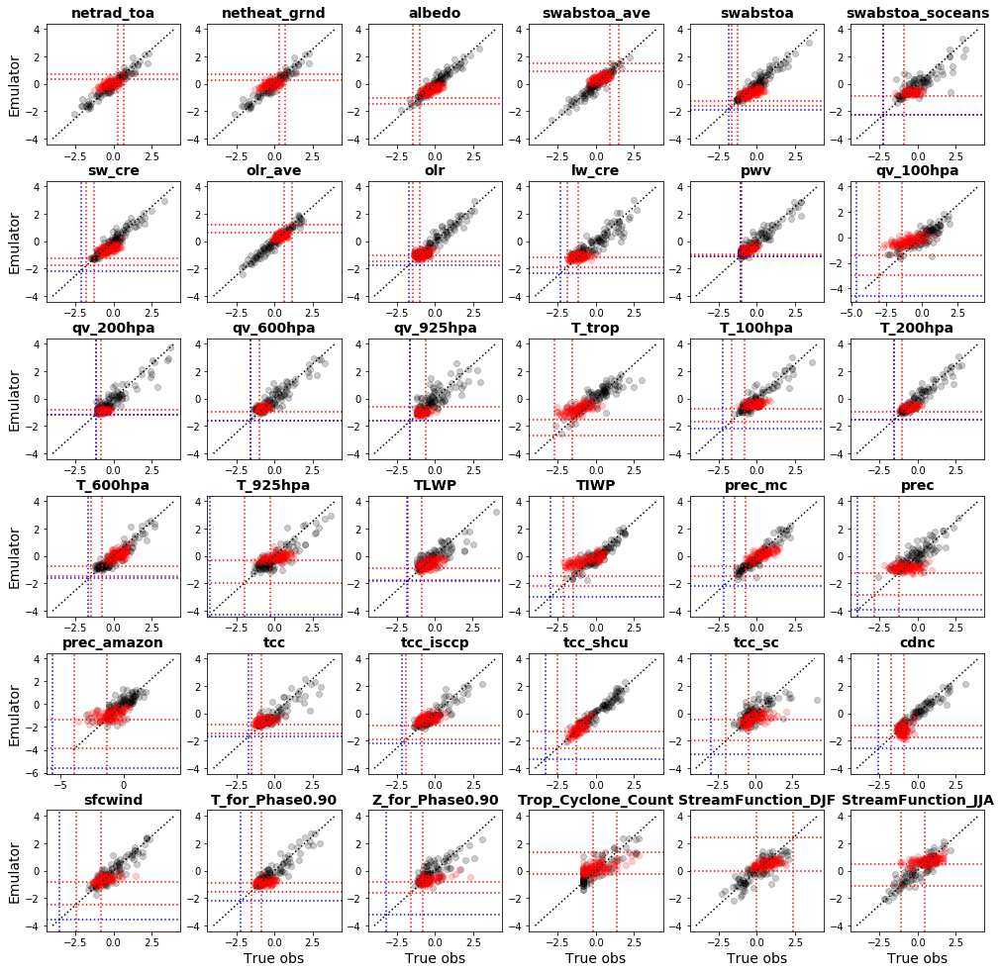

In [27]:
#..Now do the viz comparison of real vs emulated
fig = plt.figure(figsize=(14,14))
ii=1
gs = gridspec.GridSpec(6,6)
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    plt.scatter(obs_eval_stan[i,:], test_predictions[:,i],c='k',alpha=0.2)
    #plt.scatter(obs_post_nnMEAN_stan[i,:], obs_post_nnMEAN_emulator[:,i],c='r',alpha=0.2)
    plt.scatter(obs_post_nn3_stan[i,:], obs_post_nn3_emulator[:,i],c='r',alpha=0.2)
    plt.plot([-4,4],[-4,4],'k:')
    ax.axvline(gminmax_stan[i,0],c='r',ls=':')
    ax.axvline(gminmax_stan[i,1],c='r',ls=':')
    ax.axhline(gminmax_stan[i,0],c='r',ls=':')
    ax.axhline(gminmax_stan[i,1],c='r',ls=':')
    if is_rmse[i]:
        ax.axhline(zero_stan[i],c='b',ls=':')
        ax.axvline(zero_stan[i],c='b',ls=':')
    plt.title(obs_labs[i],fontsize=14,fontweight='bold')
    if (i>30):
        ax.set_xlabel('True obs',fontsize=14)
    if (i % 6 == 0):
        ax.set_ylabel('Emulator',fontsize=14)
    ii +=1
gs.update(hspace=.3,top=.96,bottom=0.05,right=0.99,left=0.05)
#fig.savefig('training_vs_posterior_nnv3_linear_dnn03_traineval.png')

In [52]:
print(obs_post_nnMEAN_emulator.shape)
print(obs_post_nnMEAN_stan.shape)

(100, 36)
(36, 100)


In [53]:
#..Now cacalate the individual contributions to likelihood from each of the mmebers.
#..Loop over the obs dimensions
like_out_nnMEAN_E3 = copy.deepcopy(obs_post_nnMEAN_emulator)
like_out_nnMEAN_nn = copy.deepcopy(obs_post_nnMEAN_emulator)
for i in range(nobs):
    for j in range(100):
        like_out_nnMEAN_E3[j,i] = np.log10(scipy.stats.norm(omean_stan[i], 
                                                            ostd_stan[i]).pdf(obs_post_nnMEAN_stan[i,j]))
        like_out_nnMEAN_nn[j,i] = np.log10(scipy.stats.norm(omean_stan[i], 
                                                            ostd_stan[i]).pdf(obs_post_nnMEAN_emulator[j,i]))


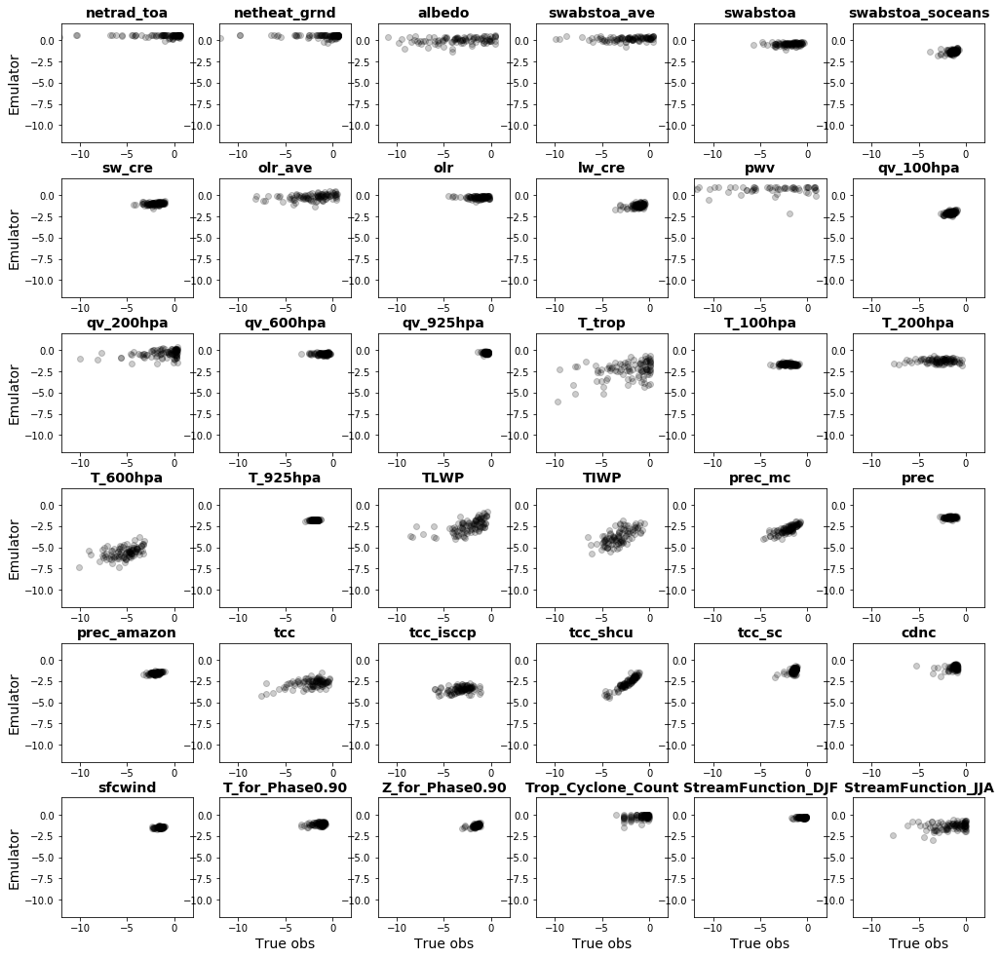

In [56]:
#..Now plot it
#..Now do the viz comparison of real vs emulated
fig = plt.figure(figsize=(14,14))
ii=1
gs = gridspec.GridSpec(6,6)
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    plt.scatter(like_out_nnMEAN_E3[:,i], like_out_nnMEAN_nn[:,i],c='k',alpha=0.2)
    ax.set_xlim(-12.,2.)
    ax.set_ylim(-12.,2.)
    #plt.scatter(obs_post_nnMEAN_stan[i,:], obs_post_nnMEAN_emulator[:,i],c='r',alpha=0.2)
    plt.title(obs_labs[i],fontsize=14,fontweight='bold')
    if (i>30):
        ax.set_xlabel('True obs',fontsize=14)
    if (i % 6 == 0):
        ax.set_ylabel('Emulator',fontsize=14)
    ii +=1
gs.update(hspace=.3,top=.96,bottom=0.05,right=0.99,left=0.05)
fig.savefig('loglike_nnv3_linear_dnn03_traineval.png')

(-60, -40)

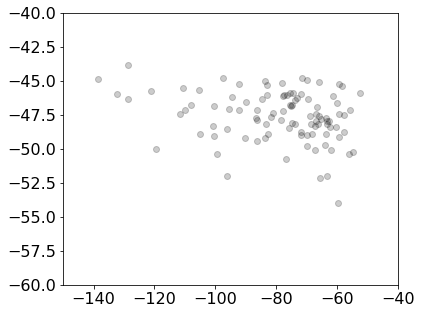

In [89]:
fig=plt.figure(figsize=(6,5))
ax = fig.add_subplot(111)
ax.scatter(like_out_nnMEAN_E3[:,:].sum(axis=1), like_out_nnMEAN_nn[:,:].sum(axis=1),c='k',alpha=0.2)
ax.set_xlim(-150,-40)
ax.set_ylim(-60,-40)

In [104]:
from mpl_toolkits.mplot3d import Axes3D

In [229]:
#..Use the defined function of log-likelihood (or likelihood) to map out the response surface in a 
#..couple dimensions at a time

#..First make a parmeter matrix (nparams,nsamples) that varies in two dimensions but not others.
#..Collect some "good" parameteter values --- just use the mean 
#params_post_nnMEAN_norm_mean = params_post_nnMEAN_norm.mean(axis=1)
params_post_nnMEAN_norm_mean = samples.mean(axis=1)
print(params_post_nnMEAN_norm_mean.shape)

#idx1 = 10   #..idx1=10: the 11th parameter
#idx2 = 31   #..idx2=31: the 32nd parameter

#idx1 = 3
#idx2 = 8

#idx1 = 29    #...these wer pretty good ones
#idx2 = 42

idx1 = 29
idx2 = 32

#Make a covariance matrix for the stuffs

#Now make the matrix, only varying the indices indicated. Do 100 samples I guess in each dim
#             
nres = 40
par_norm_mat = np.zeros((npar,nres,nres))
obs_stan_mat = np.zeros((nobs,nres,nres))
loglike_mat  = np.zeros((nres,nres))
print(par_norm_mat.shape)
for i in range(par_norm_mat.shape[1]):
    for j in range(par_norm_mat.shape[2]):
        par_norm_mat[:,i,j] = params_post_nnMEAN_norm_mean[:]
        par_norm_mat[idx1,i,j] = 1.*((i+0.5)/nres)
        par_norm_mat[idx2,i,j] = 1.*((j+0.5)/nres)
for i in range(par_norm_mat.shape[1]):
    for j in range(par_norm_mat.shape[2]):
        obs_stan_mat[:,i,j] = (model_01.predict(np.array([par_norm_mat[:,i,j]])) + 
                               model_02.predict(np.array([par_norm_mat[:,i,j]])) +
                               model_04.predict(np.array([par_norm_mat[:,i,j]])) + 
                               model_05.predict(np.array([par_norm_mat[:,i,j]])) +
                               model_06.predict(np.array([par_norm_mat[:,i,j]])) + 
                               model_11.predict(np.array([par_norm_mat[:,i,j]])))/6.
        loglike_mat[i,j] = scipy.stats.multivariate_normal(omean_stan[:],Rcov).logpdf(obs_stan_mat[:,i,j])


# np.log10(scipy.stats.norm(

(45,)
(45, 40, 40)


In [252]:
for idx in range(36):
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(111)
    plt.pcolormesh(X,Y,obs_stan_mat[idx,:,:],cmap=cm.gray)
    ax.set_xlabel(par_labs[idx1],fontsize=20,fontweight='bold')
    ax.set_ylabel(par_labs[idx2],fontsize=20,fontweight='bold')
    plt.colorbar()
    plt.title(obs_labs[idx],fontsize=22,fontweight='bold')
    fig.savefig('output_thing_'+str(idx).zfill(2)+'.png')
    plt.close(fig)
    fig.clf()

In [ ]:
#..12...18..20..22..25..27..30!..32..33

In [257]:
print(params_norm.shape)

(45, 610)


In [268]:
#..Need to generate collection of training points taken within vicinity of the mean values
print(params_post_nnMEAN_norm_mean)  #..They're normalized..

#..Now find the original points within plus/minus 0.05 of this
threshold = .5
idx_good = []
for i in range(params_norm.shape[1]):
    logicaly = True
    for j in range(params_norm.shape[0]):
        if ( (j != idx1) and (j != idx2)):
            if ( (params_norm[j,i]>params_post_nnMEAN_norm_mean[j]-threshold) and 
                (params_norm[j,i]<params_post_nnMEAN_norm_mean[j]+threshold)):
                pass
            else:
                logicaly = False
    if(logicaly):
        idx_good = np.r_[idx_good,i]
        print(i)

        
        

[0.81164176 0.3422784  0.47846639 0.47508274 0.66147181 0.13647555
 0.7637486  0.26101769 0.63152481 0.14308662 0.45901399 0.68335926
 0.5849556  0.68488809 0.44264311 0.69538865 0.80915812 0.81775727
 0.33019817 0.51766785 0.7850048  0.83813924 0.53392562 0.58784096
 0.75135115 0.81768348 0.6360873  0.48639284 0.68914166 0.57078319
 0.54659447 0.90314564 0.61337819 0.12526582 0.90547513 0.808143
 0.12494656 0.35233721 0.56687763 0.73882656 0.50023238 0.50522439
 0.52570693 0.90275977 0.6211497 ]
491
503
573


In [274]:
#print(params_norm[:,491])
print(idx_good)
par_good = params_norm[:,int(idx_good[0])]
for i in range(1,idx_good.shape[0]):
    par_good = np.vstack((par_good,params_norm[:,int(idx_good[i])]))

# fwd_obs_good = (model_01.predict(np.array([par_good])) + 
#                 model_02.predict(np.array([par_good])) +
#                 model_04.predict(np.array([par_good])) + 
#                 model_05.predict(np.array([par_good])) +
#                 model_06.predict(np.array([par_good])) + 
#                 model_11.predict(np.array([par_good])))/6.
fwd_obs_good = (model_01.predict(par_good) + 
                model_02.predict(par_good) + 
                model_04.predict(par_good) + 
                model_05.predict(par_good) + 
                model_06.predict(par_good) +     
                model_11.predict(par_good))/6.

[491. 503. 573.]


In [277]:
print(fwd_obs_good.shape)
loglike_good = []
for i in range(fwd_obs_good.shape[0]):
    loglike_good = np.r_[loglike_good,scipy.stats.multivariate_normal(omean_stan[:],Rcov).logpdf(fwd_obs_good[i,:])]
print(loglike_good)

(3, 36)
[-175.07949324 -155.74493999 -104.84296749]


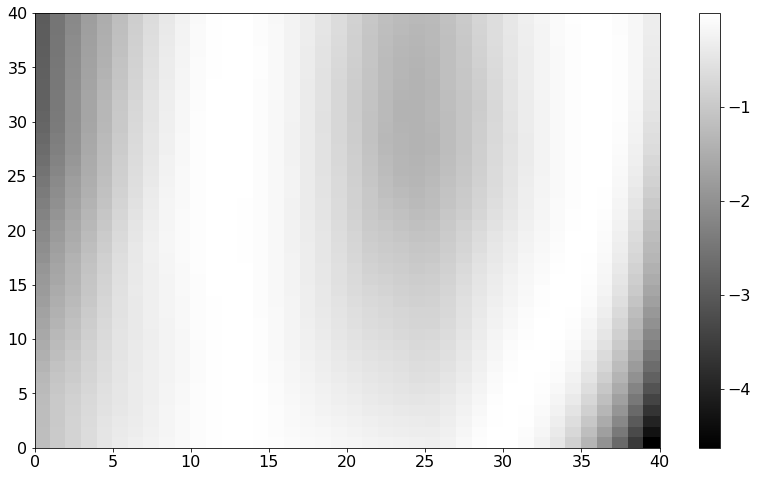

In [228]:
#lev = -0.52
lev = 0.75
loglike_30 = -(obs_stan_mat[18,:,:]-(lev + 0*obs_stan_mat[30,:,:]))**2/.01
fig = plt.figure(figsize=(14,8))
#plt.pcolormesh(loglike_30,cmap=cm.gist_ncar)
plt.pcolormesh(loglike_30,cmap=cm.gray)
#ax = fig.gca(projection='3d')
#surf = ax.plot_surface(X,Y,loglike_30,cmap=cm.magma,
#                       linewidth=0, antialiased=False)
plt.colorbar()

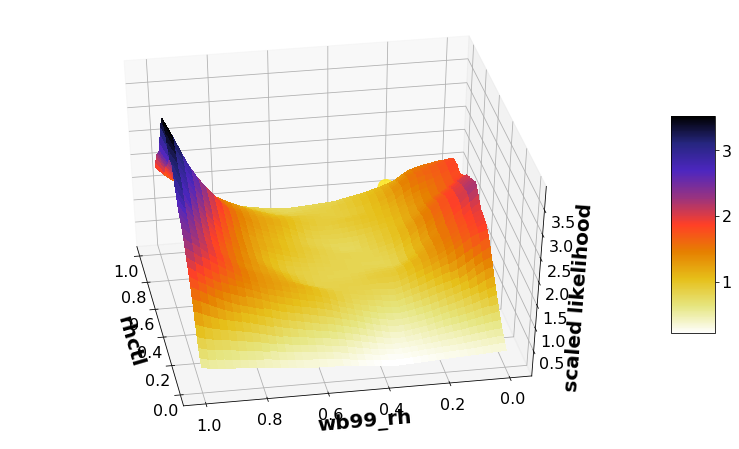

In [325]:
fig = plt.figure(figsize=(14,8))
ax = fig.gca(projection='3d')

# Make data.
X = np.linspace(0, 1, num=nres)
Y = np.linspace(0, 1, num=nres)
X, Y = np.meshgrid(X, Y)
#R = np.sqrt(X**2 + Y**2)
#Z = np.sin(R)

# Plot the surface.
surf = ax.plot_surface(X, Y, 1.e37*np.exp(loglike_mat), cmap=cm.CMRmap_r,
                       linewidth=0, antialiased=False)
Z = np.array([1.e37*np.exp(loglike_mat[10,30]+.5),1.e37*np.exp(loglike_mat[20,20]+.5)])

ax.view_init(40, 170)
#ax.set_zlim(-3.e-37,7.e-37)
ax.set_xlabel(par_labs[idx1],fontsize=20,fontweight='bold')
ax.set_ylabel(par_labs[idx2],fontsize=20,fontweight='bold')
ax.set_zlabel('scaled likelihood',fontsize=20,fontweight='bold')
ax.scatter3D(np.array([X[10,30],X[20,20]]), np.array([Y[10,30],Y[20,20]]), Z, marker='.',s=1000, 
           c=Z, alpha=0.9)
#ax.set_xticks([])
#ax.set_yticks([])
#ax.set_zticks([])

fig.colorbar(surf, shrink=0.5, aspect=5)
#fig.savefig('NN_likelihood_3d.png')

#plt.pcolormesh(loglike_mat,cmap=cm.CMRmap)

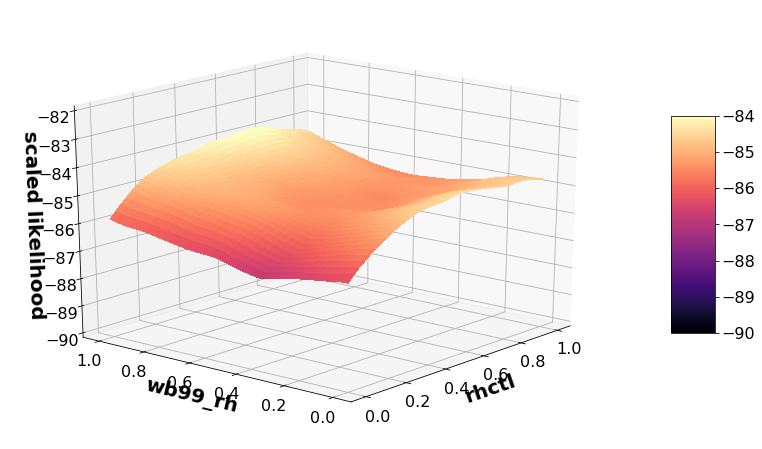

In [278]:
fig = plt.figure(figsize=(14,8))
ax = fig.gca(projection='3d')

# Make data.
X = np.linspace(0, 1, num=nres)
Y = np.linspace(0, 1, num=nres)
X, Y = np.meshgrid(X, Y)
#R = np.sqrt(X**2 + Y**2)
#Z = np.sin(R)

# Plot the surface.
#loglike_mat_ma = np.ma.masked_where(loglike_mat<-90.,loglike_mat)
loglike_mat_ma = np.where(loglike_mat>-90, loglike_mat, np.nan)
#surf = ax.plot_surface(X, Y, np.exp(loglike_mat), cmap=cm.magma,
surf = ax.plot_surface(X, Y, loglike_mat_ma, cmap=cm.magma,
                       linewidth=0, antialiased=False,vmin=-90.,vmax=-84)
ax.view_init(20, 220)
#ax.view_init(20, 320)
ax.set_zlim(-90,-82)
ax.set_xlabel(par_labs[idx1],fontsize=20,fontweight='bold')
ax.set_ylabel(par_labs[idx2],fontsize=20,fontweight='bold')
ax.set_zlabel('scaled likelihood',fontsize=20,fontweight='bold')

fig.colorbar(surf, shrink=0.5, aspect=5)
#fig.savefig('NN_loglikelihood_3d.png')

#plt.pcolormesh(loglike_mat,cmap=cm.CMRmap)

In [93]:
#..2 and 29
params_eval_norm.shape

(45, 140)

In [96]:
print(par_norm_mat.shape)
blah = copy.deepcopy(par_norm_mat[:,i,j].ravel())
print(blah.shape)
model_06.predict(np.array([blah]))

(45, 100, 100)
(45,)


array([[ 1.0356394 ,  0.9918745 , -1.5890832 ,  1.5755183 , -1.6042719 ,
        -1.3518258 , -1.5781754 ,  0.9648683 , -1.0679852 , -0.93715036,
        -0.8833928 , -0.286526  , -0.48646122, -0.71297735, -0.8723752 ,
        -0.43323195, -0.4954585 , -0.71933967,  0.27467218, -0.33505237,
        -0.6702413 , -1.1188492 ,  2.0278258 , -0.9006869 , -1.2816979 ,
        -0.45182642,  0.17350939, -0.3079692 , -0.5105331 , -0.25180894,
        -0.38262093, -1.1219857 , -1.060421  , -0.52591497,  0.44654807,
         0.13412593]], dtype=float32)

In [114]:
print(params.shape)
print(samples.shape)

(44, 440)
(44, 40000)


[11.5337084   9.24395736 13.62029348 14.38277521  6.54659409  7.65824259
  9.10170365 10.49647078 13.21859145 10.9856819  13.61646264 11.00832864
 14.52115069  9.10354803 11.05919905 12.35264949 10.5240271   9.31973261
  8.56514067 13.73861218  8.51215101 10.83630549 14.82602908 14.49228371
 13.99177388 11.57227397 10.63306375 13.64634301 11.95377715 11.3437037
  9.8455115   7.54919267 13.26988015 14.42623389  8.24562569  5.23863474
 11.42499812  8.02796813 12.83872643 14.33428192 10.20405893  5.91088283
 10.81698482 11.48314436]
(44, 100)


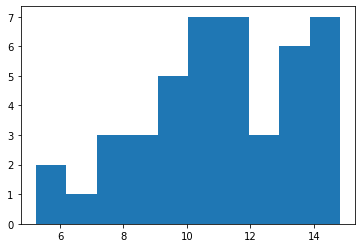

In [129]:
plt.hist(subsamp[5,5])
print(subsamp[:,5])
print(subsamp.shape)

In [131]:
print(params.shape)
print(subsamp.shape)
print(samples.shape)

(44, 440)
(44, 100)
(44, 40000)


In [81]:
subsamp[0,:].max()

6832.281224301526

In [67]:
print(samples.shape)
#..Draw 100 samples from the last 30,000 MCMC iterations
subsamp_norm = np.zeros((npar,100))
for i in range(100):
    ridx = 10000 + int(80000*random.random())
    #print(ridx)
    subsamp_norm[:,i] = samples[:,ridx]
print(subsamp_norm.shape)

#..Now un-normalize subsamp
subsamp = copy.deepcopy(subsamp_norm)
for i in range(npar):
    #params_eval_norm[i,:] = (params_eval_norm[i,:]-params[i,:].min())/(params[i,:].max()-params[i,:].min())
    subsamp[i,:] = subsamp_norm[i,:]*(params[i,:].max()-params[i,:].min()) + params[i,:].min()

(45, 90000)
(45, 100)


In [64]:
#..Run the emulator on subsamp_norm
obs_subsamp_stan = model.predict(subsamp_norm.T)
print(obs_subsamp_stan.shape)

#..Now un-standardize the subsamps
obs_subsamp = copy.deepcopy(obs_subsamp_stan)
for i in range(nobs):
    #obs_tune_stan[i,:] = (obs_tune_stan[i,:]-obs[i,:].mean())/obs[i,:].std()
    obs_subsamp[:,i] = obs_subsamp[:,i]*obs[i,:].std() + obs[i,:].mean()

fig = plt.figure(figsize=(14,14))
gs = gridspec.GridSpec(6,6)
ii=1
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    ak=ax.hist(obs[i,:],bins=20)
    for j in range(100):
        ax.axvline(obs_subsamp[j,i],c='k',lw=0.5,alpha=0.2)
    ax.axvline(gminmax[i,0],c='r',ls=':')
    ax.axvline(gminmax[i,1],c='r',ls=':')
    plt.title(obs_labs[i],fontsize=16,fontweight='bold')
gs.update(hspace=.3,top=.96,bottom=0.05,right=0.99,left=0.05)
#fig.savefig('emulator_obs_v3_nn07_runon08.png',dpi=150)
fig.savefig('emulator_obs_v4_nnMEAN0.png',dpi=150)


NameError: name 'model' is not defined

In [111]:
#..Now unlog the logged ones
for i in range(npar):
    #print(i,is_log[i])
    if (is_log[i]>0.5):
        print(i)
        subsamp[i,:] = 10.**(subsamp[i,:])
        

4
30
35
38
39
41


In [68]:
#..Now output this into a text file?
np.savetxt('params_nnv5_dnnMEAN00_100_NEW.txt',subsamp)

In [23]:
subsamp = np.loadtxt('params_nnv3_dnnMEAN00_100.txt')
print(subsamp.shape)

(44, 100)


In [120]:
print(params.shape)

(44, 440)


(1819.14, 10797.3)

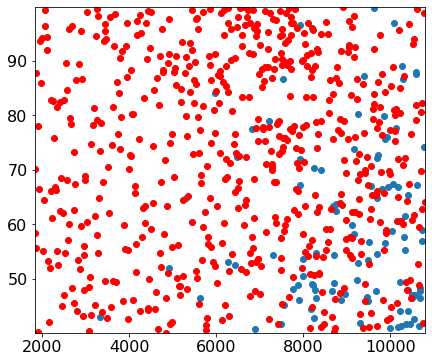

In [69]:
fig = plt.figure(figsize=(7,6))
ax  = fig.add_subplot(111)
id1 = 0
id2 = 1
ax.scatter(subsamp[id1,:],subsamp[id2,:])
#ax.set_ylim(subsamp[:,id2].min(),subsamp[:,id2].max())
#ax.set_xlim(subsamp[:,id1].min(),subsamp[:,id1].max())
ax.scatter(params[id1,:],params[id2,:],c='r')
ax.set_ylim(params[id2,:].min(),params[id2,:].max())
ax.set_xlim(params[id1,:].min(),params[id1,:].max())

In [116]:
#...Try loading points and make sure they correspond to the other ones
subsamp_file = np.loadtxt('params_nnv3_dnn03_100.txt')

(44, 100)


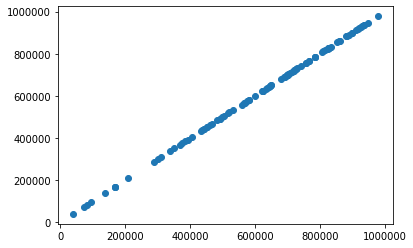

In [123]:
print(subsamp_file.shape)
plt.scatter(subsamp_file[30,:],subsamp[30,:])

In [136]:
idx_subsamp = np.array([83804,105895,99396,105384,120429,103920,61772,136547,52388,58830,
            96633,132322,87144,98130,66888,80625,89095,126674,95986,142849,132144,
            70404,92097,54243,68671,139763,69147,141653,104689,97113,132168,97160,113034,
            140506,103882,103679,142250,64905,77119,80314,54097,121686,111776,93687,53540,130068,55629,
            50747,101838,89448,70912,141700,124351,70337,119521,53098,95606,125729,137381,66071,64695,
            80740,91412,82927,99763,109926,149208,73793,71767,112345,55460,70334,126868,54186,121344,91138,
            115237,84813,128634,88540,125665,71149,58095,129522,120069,131596,114896,78158,83245,106906,136013,
            128542,92533,90176,51468,97696,73637,119496,71737,54874])
print(idx_subsamp.shape)

(100,)


In [141]:
fwd_samp = S.trace('y_model')[:,:]
print(fwd_samp.shape)
#S.summary()
fwd_subsamp = np.zeros((100,9))
for i in range(idx_subsamp.shape[0]):
    fwd_subsamp[i,:] = fwd_samp[idx_subsamp[i],:]

(150000, 9)


In [ ]:
#..Now load from file
#..Load in the evaluation data
filenm = '/home/mvanlier/Elsaesser_OBS4MIPS/tparams_gcmglobalaverages.GISS-E3emulatoreval.nc'
nc = Dataset(filenm,'r')
params_eval = nc.variables['param_vals'][:,:]
obs_eval    = nc.variables['model_annout'][:,:]
nc.close()
#..
print(params_eval.shape)
print(obs_eval.shape)
#..

In [ ]:
#.........................................................................................#
#.........................................................................................#
#.........................................................................................#

In [142]:
#..Now let's compare the emulator results to some actual results
#..Load in the evaluation data
filenm = '/home/mvanlier/Elsaesser_OBS4MIPS/tparams_gcmglobalaverages.GISS-E3candidates.nc'
nc = Dataset(filenm,'r')
params_cand = nc.variables['param_vals'][:,:]
obs_cand    = nc.variables['model_annout'][:,:]
nc.close()
#..
print(params_cand.shape)
print(obs_cand.shape)
#..

(43, 100)
(9, 100)


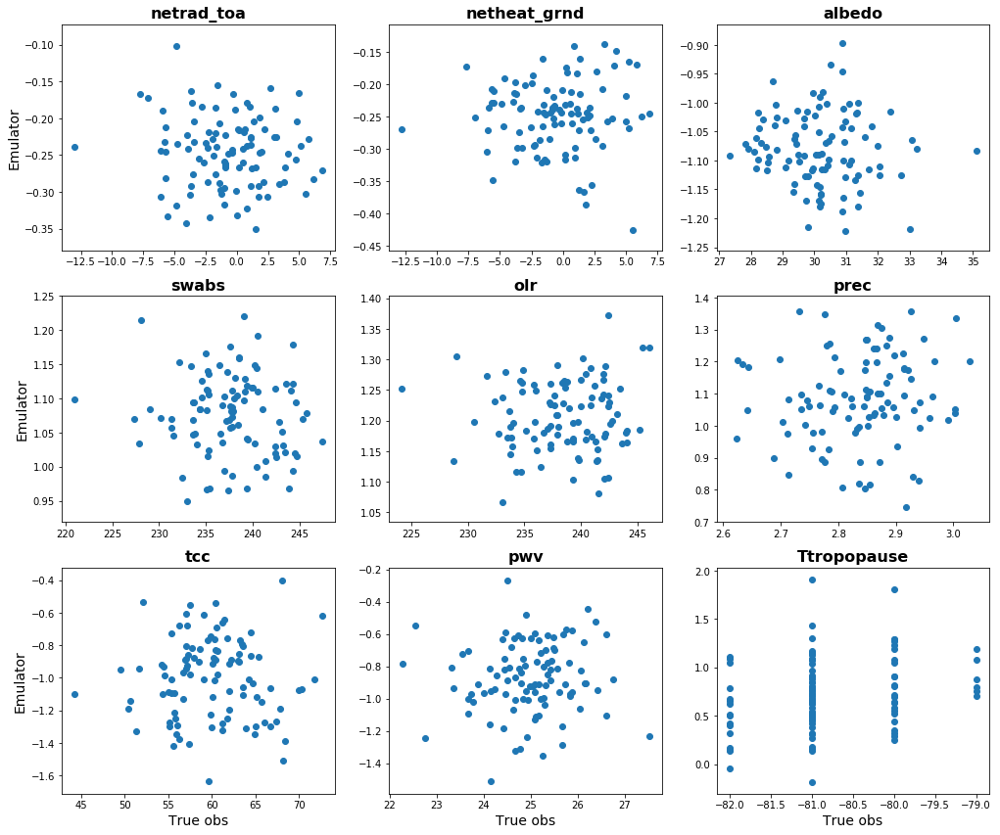

In [167]:
fig = plt.figure(figsize=(14,12))
ii=1
gs = gridspec.GridSpec(3,3)
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    plt.scatter(obs_cand[i,:], fwd_subsamp[:,i])
    #plt.plot([-4,4],[-4,4],'k:')
    plt.title(obs_labs[i],fontsize=16,fontweight='bold')
    if (i>5):
        ax.set_xlabel('True obs',fontsize=14)
    if (i==0 or i==3 or i==6):
        ax.set_ylabel('Emulator',fontsize=14)
    ii +=1
gs.update(hspace=.2,top=.96,bottom=0.05,right=0.99,left=0.05)
fig.savefig('training_vs_posterior_OLD.png')

In [144]:
#...Run the emulator on params_cand instead. something is weird with the indices above

#..First 
#..Do the same for the evaluation dataset, but use the ranges/mean/std from the training dataset
params_cand_norm = copy.deepcopy(params_cand)
for i in range(npar):
    params_cand_norm[i,:] = (params_cand_norm[i,:]-params[i,:].min())/(params[i,:].max()-params[i,:].min())

#..Standardize the outputs (mean=0, variance=1)
obs_cand_stan = copy.deepcopy(obs_cand)
for i in range(nobs):
    obs_cand_stan[i,:] = (obs_cand_stan[i,:]-obs[i,:].mean())/obs[i,:].std()

In [145]:
print(params_cand_norm.shape,obs_cand_stan.shape)

(43, 100) (9, 100)


In [146]:
#..Run emalator
obs_emcand_stan = copy.deepcopy(obs_cand_stan)
for i in range(100):
    obs_emcand_stan[:,i] = run_emulator(*params_cand_norm[:,i])

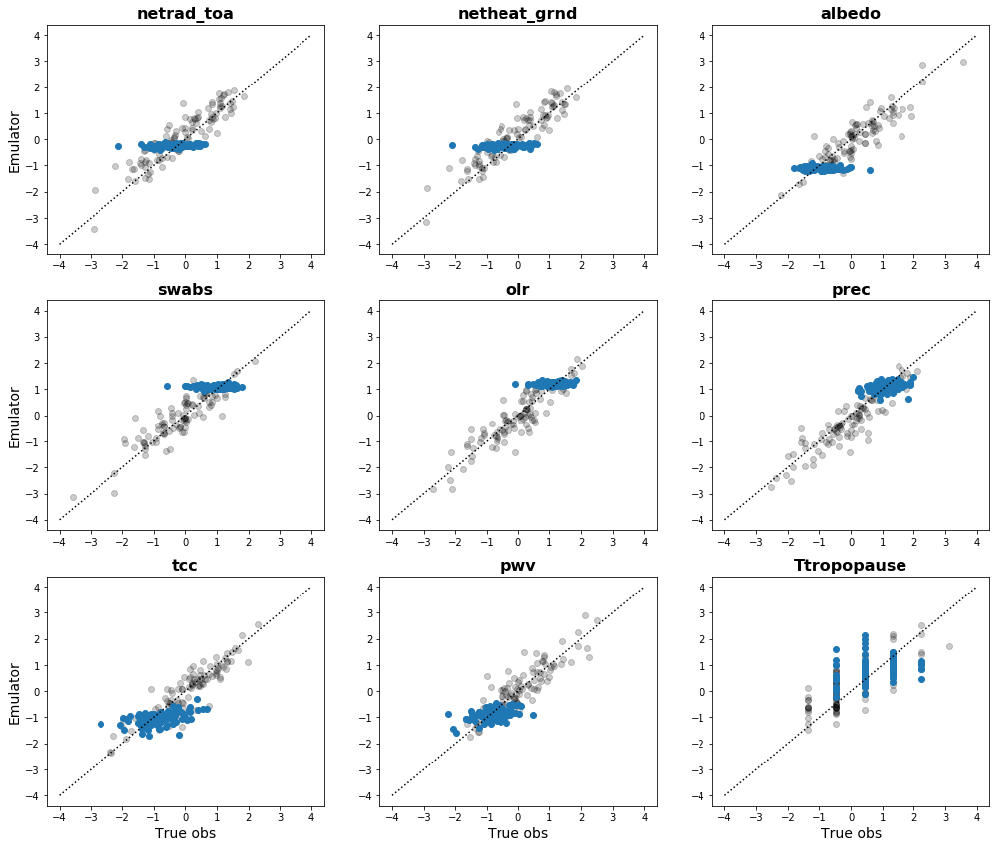

In [164]:
fig = plt.figure(figsize=(14,12))
ii=1
gs = gridspec.GridSpec(3,3)
for i in range(nobs):
    ax = fig.add_subplot(gs[i])
    plt.scatter(obs_eval_stan[i,:], test_predictions[:,i],c='k',alpha=0.2)
    plt.scatter(obs_cand_stan[i,:], obs_emcand_stan[i,:])
    plt.plot([-4,4],[-4,4],'k:')
    plt.title(obs_labs[i],fontsize=16,fontweight='bold')
    if (i>5):
        ax.set_xlabel('True obs',fontsize=14)
    if (i==0 or i==3 or i==6):
        ax.set_ylabel('Emulator',fontsize=14)
    ii +=1
gs.update(hspace=.2,top=.96,bottom=0.05,right=0.99,left=0.05)
fig.savefig('training_vs_posterior.png')

In [2]:
# #..Run using the Adaptive Metropolis sampler (Haario 2001) w/covarying proposal
# #..NOTE: you may need to run the cell two before this again to get this to work
# S = pymc.MCMC(mod)
# S.use_step_method(pymc.AdaptiveMetropolis, [S.p00,S.p01,S.p02,S.p03,S.p04,S.p05,S.p06,S.p07,S.p08,S.p09,
#                                             S.p10,S.p11,S.p12,S.p13,S.p14,S.p15,S.p16,S.p17,S.p18,S.p19,
#                                             S.p20,S.p21,S.p22,S.p23,S.p24,S.p25,S.p26,S.p27,S.p28,S.p29,
#                                             S.p30,S.p31,S.p32,S.p33,S.p34,S.p35,S.p36,S.p37,S.p38,S.p39,
#                                             S.p40,S.p41,S.p42], delay=10000)
# S.sample(iter=400000, burn=10000)

In [1]:
# samples = np.vstack((S.trace('p00')[:],S.trace('p01')[:],S.trace('p02')[:],S.trace('p03')[:],S.trace('p04')[:],
#                      S.trace('p05')[:],S.trace('p06')[:],S.trace('p07')[:],S.trace('p08')[:],S.trace('p09')[:],
#                      S.trace('p10')[:],S.trace('p11')[:],S.trace('p12')[:],S.trace('p13')[:],S.trace('p14')[:],
#                      S.trace('p15')[:],S.trace('p16')[:],S.trace('p17')[:],S.trace('p18')[:],S.trace('p19')[:],
#                      S.trace('p20')[:],S.trace('p21')[:],S.trace('p22')[:],S.trace('p23')[:],S.trace('p24')[:],
#                      S.trace('p25')[:],S.trace('p26')[:],S.trace('p27')[:],S.trace('p28')[:],S.trace('p29')[:],
#                      S.trace('p30')[:],S.trace('p31')[:],S.trace('p32')[:],S.trace('p33')[:],S.trace('p34')[:],
#                      S.trace('p35')[:],S.trace('p36')[:],S.trace('p37')[:],S.trace('p38')[:],S.trace('p39')[:],
#                      S.trace('p40')[:],S.trace('p41')[:],S.trace('p42')[:]))

# fig,axes = corner.corner(samples.T)